# Here we estimate the price of house 

## Bussiness Case:- 
* 
House Price Prediction Systems use historical real estate data to provide accurate, data-driven property valuations, transforming the traditional real estate market. These systems help buyers, sellers, and investors make informed decisions by analyzing factors like location, size, and market trends. By leveraging machine learning models, they offer faster and more transparent pricing, while the data generated can also detect shifts in the housing market, providing valuable insights into economic and regional trends. This makes house price prediction systems a crucial tool in the evolving real estate landscape.

# Domain Analysis

In [1]:
# import the total python libraries for this project
import numpy as np  # use for numerical function
import pandas as pd  # use for data cleaning and data analysis
import matplotlib.pyplot as plt  # use data visualization
import seaborn as sb  # use for data visualization
import warnings # use for warnings the ignore
warnings.filterwarnings("ignore") # call the warning

In [2]:
df=pd.read_csv('data.csv') #load the data set

In [3]:
df.head() # showing first 5 rows

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,...,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,...,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,...,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [4]:
pd.set_option("display.max_columns",None)  # for display all columns

In [5]:
df.head() # showing first 5 row

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


### Atribute Information:-
**SalePrice:-** the property's sale price in dollars. This is the target variable that we're trying to predict.\
**MSSubClass:-** The building class\
**MSZoning:-** The general zoning classification\
**LotFrontage:-** Linear feet of street connected to property\
**LotArea:-** Lot size in square feet\
**Street:=** Type of road access\
**Alley:=** Type of alley access\
**LotShape:-** General shape of property\
**LandContour:-** Flatness of the property\
**Utilities:-** Type of utilities available\
**LotConfig:-** Lot configuration\
**LandSlope:-** Slope of property\
**Neighborhood:-** Physical locations within Ames city limits\
**Condition1:-** Proximity to main road or railroad\
**Condition2:-** Proximity to main road or railroad (if a second is present)\
**BldgType:-** Type of dwelling\
**HouseStyle:-** Style of dwelling\
**OverallQual:-** Overall material and finish quality\
**OverallCond:-** Overall condition rating\
**YearBuilt:-** Original construction date\
**YearRemodAdd:-** Remodel date\
**RoofStyle:-** Type of roof\
**RoofMatl:-** Roof material\
**Exterior1st:-** Exterior covering on house\
**Exterior2nd:-** Exterior covering on house (if more than one material)\
**MasVnrType:-** Masonry veneer type\
**MasVnrArea:-** Masonry veneer area in square feet\
**ExterQual:-** Exterior material quality\
**ExterCond:-** Present condition of the material on the exterior\
**Foundation:-** Type of foundation\
**BsmtQual:-** Height of the basement\
**BsmtCond:-** General condition of the basement\
**BsmtExposure:-** Walkout or garden level basement walls\
**BsmtFinType1:-** Quality of basement finished area\
**BsmtFinSF1:-** Type 1 finished square feet\
**BsmtFinType2:-** Quality of second finished area (if present)\
**BsmtFinSF2:-** Type 2 finished square feet\
**BsmtUnfSF:-** Unfinished square feet of basement area\
**TotalBsmtSF:-** Total square feet of basement area\
**Heating:-** Type of heating\
**HeatingQC:-** Heating quality and condition\
**CentralAir:-** Central air conditioning\
**Electrical:-** Electrical system\
**1stFlrSF:-** First Floor square feet\
**2ndFlrSF:-** Second floor square feet\
**LowQualFinSF:-** Low quality finished square feet (all floors)\
**GrLivArea:-** Above grade (ground) living area square feet\
**BsmtFullBath:-** Basement full bathrooms\
**BsmtHalfBath:-** Basement half bathrooms\
**FullBath:-** Full bathrooms above grade\
**HalfBath:-** Half baths above grade\
**Bedroom:-** Number of bedrooms above basement level\
**Kitchen:-** Number of kitchens\
**KitchenQual:-** Kitchen quality\
**TotRmsAbvGrd:-** Total rooms above grade (does not include bathrooms)\
**Functional:-** Home functionality rating\
**Fireplaces:-** Number of fireplaces\
**FireplaceQu:-** Fireplace quality\
**GarageType:-** Garage location\
**GarageYrBlt:-** Year garage was built\
**GarageFinish:-** Interior finish of the garage\
**GarageCars:-** Size of garage in car capacity\
**GarageArea:-** Size of garage in square feet\
**GarageQual:-** Garage quality\
**GarageCond:-** Garage condition\
**PavedDrive:-** Paved driveway\
**WoodDeckSF:-** Wood deck area in square feet\
**OpenPorchSF:-** Open porch area in square feet\
**EnclosedPorch:-** Enclosed porch area in square feet\
**3SsnPorch:-** Three season porch area in square feet\
**ScreenPorch:-** Screen porch area in square feet\
**PoolArea:-** Pool area in square feet\
**PoolQC:-** Pool quality\
**Fence:-** Fence quality\
**MiscFeature:-** Miscellaneous feature not covered in other categories\
**MiscVal:-** $Value of miscellaneous feature\
**MoSold:-** Month Sold\
**YrSold:-** Year Sold\
**SaleType:-** Type of sale\
**SaleCondition:-** Condition of sale

# Basic Check

In [6]:
df.head() #showing first 5 rows of data set

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500
1,2,20,RL,80.0,9600,Pave,NaN,Reg,Lvl,AllPub,FR2,Gtl,Veenker,Feedr,Norm,1Fam,1Story,6,8,1976,1976,Gable,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,Gd,TA,Gd,ALQ,978,Unf,0,284,1262,GasA,Ex,Y,SBrkr,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,TA,Attchd,1976.0,RFn,2,460,TA,TA,Y,298,0,0,0,0,0,NaN,NaN,NaN,0,5,2007,WD,Normal,181500
2,3,60,RL,68.0,11250,Pave,NaN,IR1,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2001,2002,Gable,CompShg,VinylSd,VinylSd,BrkFace,162.0,Gd,TA,PConc,Gd,TA,Mn,GLQ,486,Unf,0,434,920,GasA,Ex,Y,SBrkr,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,TA,Attchd,2001.0,RFn,2,608,TA,TA,Y,0,42,0,0,0,0,NaN,NaN,NaN,0,9,2008,WD,Normal,223500
3,4,70,RL,60.0,9550,Pave,NaN,IR1,Lvl,AllPub,Corner,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,5,1915,1970,Gable,CompShg,Wd Sdng,Wd Shng,NaN,0.0,TA,TA,BrkTil,TA,Gd,No,ALQ,216,Unf,0,540,756,GasA,Gd,Y,SBrkr,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,Gd,Detchd,1998.0,Unf,3,642,TA,TA,Y,0,35,272,0,0,0,NaN,NaN,NaN,0,2,2006,WD,Abnorml,140000
4,5,60,RL,84.0,14260,Pave,NaN,IR1,Lvl,AllPub,FR2,Gtl,NoRidge,Norm,Norm,1Fam,2Story,8,5,2000,2000,Gable,CompShg,VinylSd,VinylSd,BrkFace,350.0,Gd,TA,PConc,Gd,TA,Av,GLQ,655,Unf,0,490,1145,GasA,Ex,Y,SBrkr,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,TA,Attchd,2000.0,RFn,3,836,TA,TA,Y,192,84,0,0,0,0,NaN,NaN,NaN,0,12,2008,WD,Normal,250000


In [7]:
df.tail() #showing last 5 rows of data set

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
1455,1456,60,RL,62.0,7917,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Gilbert,Norm,Norm,1Fam,2Story,6,5,1999,2000,Gable,CompShg,VinylSd,VinylSd,NaN,0.0,TA,TA,PConc,Gd,TA,No,Unf,0,Unf,0,953,953,GasA,Ex,Y,SBrkr,953,694,0,1647,0,0,2,1,3,1,TA,7,Typ,1,TA,Attchd,1999.0,RFn,2,460,TA,TA,Y,0,40,0,0,0,0,NaN,NaN,NaN,0,8,2007,WD,Normal,175000
1456,1457,20,RL,85.0,13175,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NWAmes,Norm,Norm,1Fam,1Story,6,6,1978,1988,Gable,CompShg,Plywood,Plywood,Stone,119.0,TA,TA,CBlock,Gd,TA,No,ALQ,790,Rec,163,589,1542,GasA,TA,Y,SBrkr,2073,0,0,2073,1,0,2,0,3,1,TA,7,Min1,2,TA,Attchd,1978.0,Unf,2,500,TA,TA,Y,349,0,0,0,0,0,NaN,MnPrv,NaN,0,2,2010,WD,Normal,210000
1457,1458,70,RL,66.0,9042,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Crawfor,Norm,Norm,1Fam,2Story,7,9,1941,2006,Gable,CompShg,CemntBd,CmentBd,NaN,0.0,Ex,Gd,Stone,TA,Gd,No,GLQ,275,Unf,0,877,1152,GasA,Ex,Y,SBrkr,1188,1152,0,2340,0,0,2,0,4,1,Gd,9,Typ,2,Gd,Attchd,1941.0,RFn,1,252,TA,TA,Y,0,60,0,0,0,0,NaN,GdPrv,Shed,2500,5,2010,WD,Normal,266500
1458,1459,20,RL,68.0,9717,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,5,6,1950,1996,Hip,CompShg,MetalSd,MetalSd,NaN,0.0,TA,TA,CBlock,TA,TA,Mn,GLQ,49,Rec,1029,0,1078,GasA,Gd,Y,FuseA,1078,0,0,1078,1,0,1,0,2,1,Gd,5,Typ,0,NaN,Attchd,1950.0,Unf,1,240,TA,TA,Y,366,0,112,0,0,0,NaN,NaN,NaN,0,4,2010,WD,Normal,142125
1459,1460,20,RL,75.0,9937,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,Edwards,Norm,Norm,1Fam,1Story,5,6,1965,1965,Gable,CompShg,HdBoard,HdBoard,NaN,0.0,Gd,TA,CBlock,TA,TA,No,BLQ,830,LwQ,290,136,1256,GasA,Gd,Y,SBrkr,1256,0,0,1256,1,0,1,1,3,1,TA,6,Typ,0,NaN,Attchd,1965.0,Fin,1,276,TA,TA,Y,736,68,0,0,0,0,NaN,NaN,NaN,0,6,2008,WD,Normal,147500


In [8]:
df.describe() # showing continuous column's information

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
count,1460.000000,1460.000000,1201.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1452.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1379.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000,1460.000000
mean,730.500000,56.897260,70.049958,10516.828082,6.099315,5.575342,1971.267808,1984.865753,103.685262,443.639726,46.549315,567.240411,1057.429452,1162.626712,346.992466,5.844521,1515.463699,0.425342,0.057534,1.565068,0.382877,2.866438,1.046575,6.517808,0.613014,1978.506164,1.767123,472.980137,94.244521,46.660274,21.954110,3.409589,15.060959,2.758904,43.489041,6.321918,2007.815753,180921.195890
std,421.610009,42.300571,24.284752,9981.264932,1.382997,1.112799,30.202904,20.645407,181.066207,456.098091,161.319273,441.866955,438.705324,386.587738,436.528436,48.623081,525.480383,0.518911,0.238753,0.550916,0.502885,0.815778,0.220338,1.625393,0.644666,24.689725,0.747315,213.804841,125.338794,66.256028,61.119149,29.317331,55.757415,40.177307,496.123024,2.703626,1.328095,79442.502883
min,1.000000,20.000000,21.000000,1300.000000,1.000000,1.000000,1872.000000,1950.000000,0.000000,0.000000,0.000000,0.000000,0.000000,334.000000,0.000000,0.000000,334.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,0.000000,1900.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,2006.000000,34900.000000
25%,365.750000,20.000000,59.000000,7553.500000,5.000000,5.000000,1954.000000,1967.000000,0.000000,0.000000,0.000000,223.000000,795.750000,882.000000,0.000000,0.000000,1129.500000,0.000000,0.000000,1.000000,0.000000,2.000000,1.000000,5.000000,0.000000,1961.000000,1.000000,334.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2007.000000,129975.000000
50%,730.500000,50.000000,69.000000,9478.500000,6.000000,5.000000,1973.000000,1994.000000,0.000000,383.500000,0.000000,477.500000,991.500000,1087.000000,0.000000,0.000000,1464.000000,0.000000,0.000000,2.000000,0.000000,3.000000,1.000000,6.000000,1.000000,1980.000000,2.000000,480.000000,0.000000,25.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000,2008.000000,163000.000000
75%,1095.250000,70.000000,80.000000,11601.500000,7.000000,6.000000,2000.000000,2004.000000,166.000000,712.250000,0.000000,808.000000,1298.250000,1391.250000,728.000000,0.000000,1776.750000,1.000000,0.000000,2.000000,1.000000,3.000000,1.000000,7.000000,1.000000,2002.000000,2.000000,576.000000,168.000000,68.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,2009.000000,214000.000000
max,1460.000000,190.000000,313.000000,215245.000000,10.000000,9.000000,2010.000000,2010.000000,1600.000000,5644.000000,1474.000000,2336.000000,6110.000000,4692.000000,2065.000000,572.000000,5642.000000,3.000000,2.000000,3.000000,2.000000,8.000000,3.000000,14.000000,3.000000,2010.000000,4.000000,1418.000000,857.000000,547.000000,552.000000,508.000000,480.000000,738.000000,15500.000000,12.000000,2010.000000,755000.000000


### Here are some key insights from the numerical data
* Lot Frontage: Average is 70 feet, with missing values and significant variation.
* Lot Area: Average lot size is 10,516 sq. ft., ranging from 1,300 to 215,245 sq. ft..
* Overall Quality: Average quality score is 6.1 out of 10, with moderate variation.
* Year Built: Average home was built in 1971, with many remodels around 1984.
* Garage: Average garage area is 472 sq. ft., with capacity for 1.76 cars.
* Basement: Average total basement area is 1,057 sq. ft., some homes have no basement.
* Living Area: Above-ground living area averages 1,515 sq. ft., with large variation.
* Sale Price: Average price is 180,921, ranging from 34,900 to 755,000.
* Bedrooms/Bathrooms: Average home has 2.87 bedrooms and 1.56 full bathrooms.
* Fireplaces: Average home has 0.61 fireplaces, with some homes having up to 3.
* Age at Sale: Homes are, on average, 36 years old at the time of sale.

In [9]:
df.describe(include='O') # showing categorical column's information

,MSZoning,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinType2,Heating,HeatingQC,CentralAir,Electrical,KitchenQual,Functional,FireplaceQu,GarageType,GarageFinish,GarageQual,GarageCond,PavedDrive,PoolQC,Fence,MiscFeature,SaleType,SaleCondition
count,1460,1460,91,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,1460,588,1460,1460,1460,1423,1423,1422,1423,1422,1460,1460,1460,1459,1460,1460,770,1379,1379,1379,1379,1460,7,281,54,1460,1460
unique,5,2,2,4,4,2,5,3,25,9,8,5,8,6,8,15,16,3,4,5,6,4,4,4,6,6,6,5,2,5,4,7,5,6,3,5,5,3,3,4,4,9,6
top,RL,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Norm,Norm,1Fam,1Story,Gable,CompShg,VinylSd,VinylSd,BrkFace,TA,TA,PConc,TA,TA,No,Unf,Unf,GasA,Ex,Y,SBrkr,TA,Typ,Gd,Attchd,Unf,TA,TA,Y,Gd,MnPrv,Shed,WD,Normal
freq,1151,1454,50,925,1311,1459,1052,1382,225,1260,1445,1220,726,1141,1434,515,504,445,906,1282,647,649,1311,953,430,1256,1428,741,1365,1334,735,1360,380,870,605,1311,1326,1340,3,157,49,1267,1198


### Here are some key insights from the categorical data :

* Zoning (MSZoning): The majority of homes are in the "RL" (Residential Low Density) zone, which accounts for 78.8% of the data.
* Street Type: Almost all homes are on a "Paved" street (99.6%), with very few on a "Gravel" street.
* Alley Access: Only 91 homes have alley access, with "Gravel" being more common than "Paved".
* Lot Shape: 63.4% of properties have a "Regular" (Reg) lot shape, indicating standard plots.
* Utilities: Almost all homes (99.9%) have "All Public" utilities available.
* Neighborhood: "NAmes" is the most common neighborhood, comprising 15.4% of homes.
* Building Type: The majority of homes (83.6%) are classified as "1Fam" (single-family).
* Roof Material: "CompShg" (Composite Shingles) is the dominant roofing material (78.1%).
* Exterior Material: "Vinyl Siding" is the most common exterior material for both sides (35.3% and 34.5% for Exterior1st and Exterior2nd).
* Basement Quality (BsmtQual): 44.3% of homes have "TA" (Typical/Average) basement quality.
* Central Air: 97.8% of homes are equipped with central air conditioning.
* Garage Type: "Attached" garages are the most common (93.1%).
* Fence: Only 19.2% of homes have fences, with "MnPrv" (Minimum Privacy) being the most common fence type.
* Sale Condition: Most homes (86.9%) are sold under "Normal" conditions.

In [10]:
df.info() # showing some basic information of data

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [11]:
numerical_col = df.select_dtypes(include=['int64', 'float64']).columns #showing numerical columns in dataset
numerical_col

Index(['Id', 'MSSubClass', 'LotFrontage', 'LotArea', 'OverallQual',
       'OverallCond', 'YearBuilt', 'YearRemodAdd', 'MasVnrArea', 'BsmtFinSF1',
       'BsmtFinSF2', 'BsmtUnfSF', 'TotalBsmtSF', '1stFlrSF', '2ndFlrSF',
       'LowQualFinSF', 'GrLivArea', 'BsmtFullBath', 'BsmtHalfBath', 'FullBath',
       'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr', 'TotRmsAbvGrd',
       'Fireplaces', 'GarageYrBlt', 'GarageCars', 'GarageArea', 'WoodDeckSF',
       'OpenPorchSF', 'EnclosedPorch', '3SsnPorch', 'ScreenPorch', 'PoolArea',
       'MiscVal', 'MoSold', 'YrSold', 'SalePrice'],
      dtype='object')

In [12]:
len(numerical_col) # showing how many features in numerical 

38

In [13]:
categorical_col = df.select_dtypes(include='object').columns # showing categorical columns in dataset
categorical_col

Index(['MSZoning', 'Street', 'Alley', 'LotShape', 'LandContour', 'Utilities',
       'LotConfig', 'LandSlope', 'Neighborhood', 'Condition1', 'Condition2',
       'BldgType', 'HouseStyle', 'RoofStyle', 'RoofMatl', 'Exterior1st',
       'Exterior2nd', 'MasVnrType', 'ExterQual', 'ExterCond', 'Foundation',
       'BsmtQual', 'BsmtCond', 'BsmtExposure', 'BsmtFinType1', 'BsmtFinType2',
       'Heating', 'HeatingQC', 'CentralAir', 'Electrical', 'KitchenQual',
       'Functional', 'FireplaceQu', 'GarageType', 'GarageFinish', 'GarageQual',
       'GarageCond', 'PavedDrive', 'PoolQC', 'Fence', 'MiscFeature',
       'SaleType', 'SaleCondition'],
      dtype='object')

In [14]:
len(categorical_col) # showing how many features in categorical 

43

In [15]:
df.shape # showing how many columns and rows in this dataset

(1460, 81)

# EDA:- Exploratory Data Analysis

**Exploratory Data Analysis (EDA):-**  EDA in machine learning is the process of analyzing and visualizing datasets to summarize their main characteristics, often using statistical graphics and visualization techniques.

**There are Three types of EDA :**
1. Univerient Analysis
2. Biverient Analysis
3. Multiverient Analysis

In [16]:
for column in numerical_col:
    print(column) # showing all columns name 

Id
MSSubClass
LotFrontage
LotArea
OverallQual
OverallCond
YearBuilt
YearRemodAdd
MasVnrArea
BsmtFinSF1
BsmtFinSF2
BsmtUnfSF
TotalBsmtSF
1stFlrSF
2ndFlrSF
LowQualFinSF
GrLivArea
BsmtFullBath
BsmtHalfBath
FullBath
HalfBath
BedroomAbvGr
KitchenAbvGr
TotRmsAbvGrd
Fireplaces
GarageYrBlt
GarageCars
GarageArea
WoodDeckSF
OpenPorchSF
EnclosedPorch
3SsnPorch
ScreenPorch
PoolArea
MiscVal
MoSold
YrSold
SalePrice


### Univerient Analysis

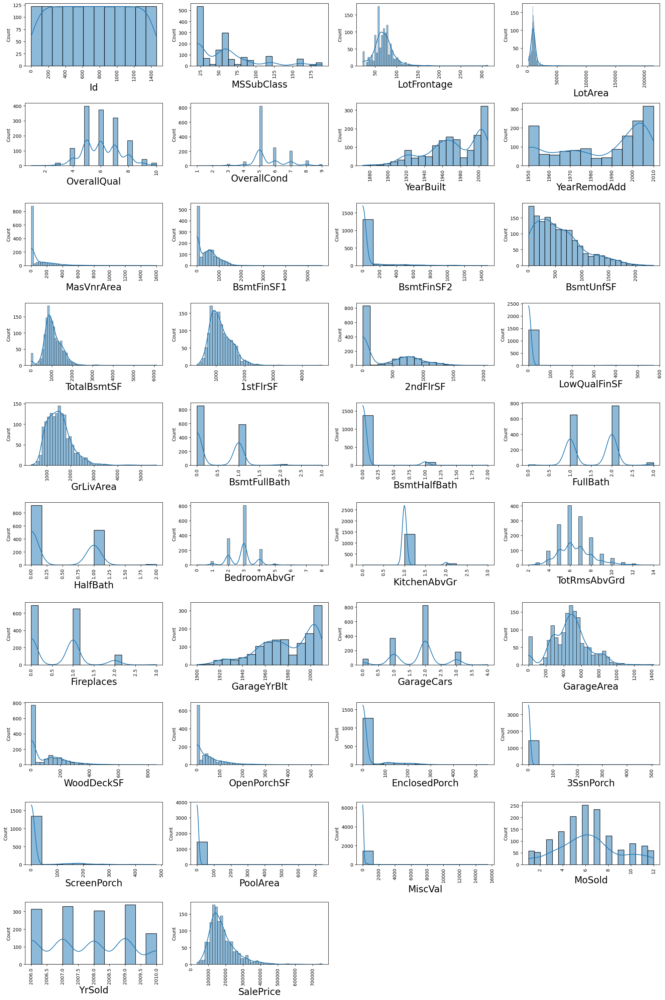

In [17]:
# univerient visualization  
plt.figure(figsize=(20,30)) # define the plot size
plt_num=1
for column in numerical_col:
    if plt_num <= 38: # assighn the column value
        plt.subplot(10,4,plt_num) # row and column assighn
        sb.histplot(df[column],kde=True) # create the histogram plot
        plt.xlabel(column,fontsize=20)
        plt.xticks(rotation = 90)# assighn the xlabel value
    plt_num+=1
plt.tight_layout() # use for data show function

**Insights:-**
* Here we can see the normal distibution in 1stFlrSF and GrLivArea and TotalBsmtSF.
* Here we are normal distribution time use mean, median or mode equall but not normal distribution time only use median.

## Biverient Analysis

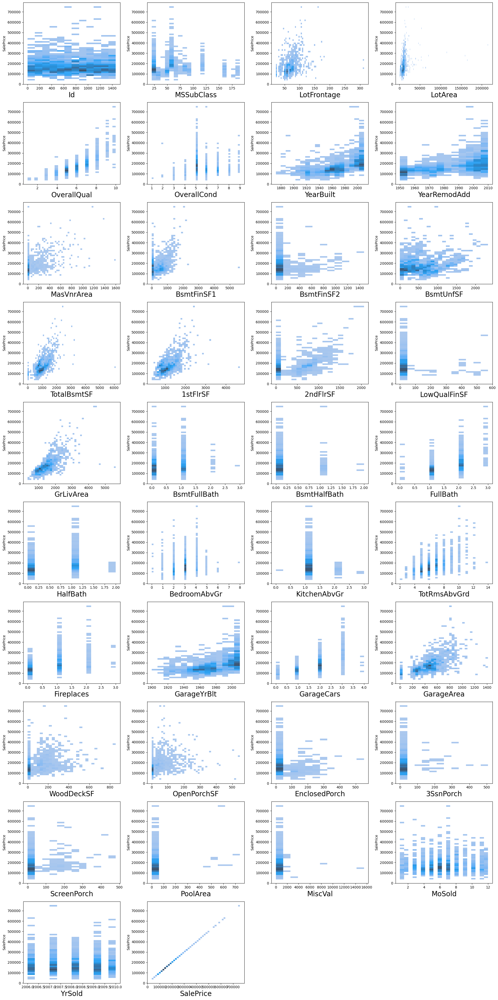

In [18]:
# Bivrainat Analysis of numerical columns
plt.figure(figsize=(20,40)) 
plt_num=1
for column in numerical_col:
    if plt_num <= 38:
        plt.subplot(10,4,plt_num)
        sb.histplot(x = df[column],y = df.SalePrice,kde=True)
        plt.xlabel(column,fontsize=20)
    plt_num+=1
plt.tight_layout()

**Insights:-**
* Here we can see the possitvie corelation between 1stFlrSF and SalesPrice.
* Here we can see the possitvie corelation between GrLivArea and SalesPrice.

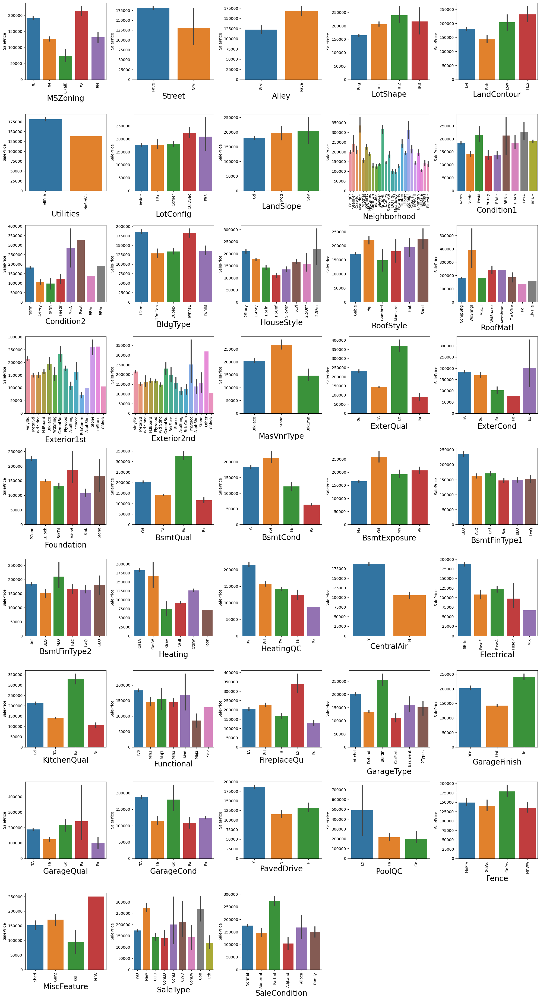

In [19]:
# Biavariant Analysis of categorical columns
plt.figure(figsize=(20,40)) # univerient visualization
plt_num=1
for column in categorical_col:
    if plt_num <= 43:
        plt.subplot(10,5,plt_num)
        sb.barplot(x = df[column],y = df.SalePrice)
        plt.xlabel(column,fontsize=20)
        plt.xticks(rotation = 90)# assighn the xlabel value
    plt_num+=1
plt.tight_layout()

**Insights:-**
* Highest MSZoning: FV
* Highest Street: Paved
* Highest Alley: Paved
* Highest LotShape: IR2
* Highest LandContour: HLS
* Highest Utilities: AllPub
* Highest LotConfig: CulDeSac
* Highest LandSlope: Severe
* Highest BldgType: 1Fam
* Highest RoofStyle: Shed
* Highest MasVnrType: Stone
* Highest ExterQual/Cond: Excellent (Ex)
* Highest Foundation: PConc
* Highest BsmtQual/Cond/Exposure: Excellent (Ex)/Good (Gd)
* Highest BsmtFinType1: GLQ
* Highest Heating: GasA
* Highest HeatingQC: Excellent (Ex)
* Highest CentralAir: Yes (Y)
* Highest Electrical: SBrkr
* Highest Functional: Typical (Typ)
* Highest GarageType: Built-In
* Highest GarageFinish: Finished (Fin)
* Highest Fence: GdPrv

### Multiverient Analysis

In [20]:
sb.pairplot(df,hue='SalePrice') # used for check dataset columns relationship

## Final EDA Report
* The dataset reveals several key patterns related to house prices. There is a positive correlation between 1st Floor Square Feet (1stFlrSF) and Ground Living Area (GrLivArea) with SalesPrice, indicating that larger living spaces lead to higher prices.
* In terms of zoning, houses in the FV (Floating Village) zone tend to have the highest prices, while nearly all homes are located on Paved streets. Additionally, Paved alleys, IR2 lot shapes, and HLS land contours are associated with higher sales prices.
*  Homes with high-quality external features, such as Stone veneer, Excellent exterior condition (ExterQual), and Poured Concrete (PConc) foundations, command premium prices. Features like Central Air (Y), GLQ basement finishing, and Built-in garages also contribute to increased property value.








# Feature Engineering

**Feature Engineering:-** Feature engineering is the process of creating new input features or modifying existing ones to improve model performance. It involves techniques like combining variables, extracting useful information, or transforming data to highlight important patterns. Good feature engineering can enhance a model's predictive power.

**There are two stage of feature engineering**
1. Data Preprocessing
2. Feature Selection

### 1. Data Preprocessing:-

* Data preprocessing is the process of cleaning and transforming raw data into a usable format for analysis. It involves handling missing values, encoding categorical variables, scaling features, and removing noise to ensure the data is ready for model building. Effective preprocessing improves model accuracy and performance.

In [21]:
pd.set_option("display.max_rows",None)  # display all columns

In [22]:
df.isnull().sum() #checking null values

Id                  0
MSSubClass          0
MSZoning            0
LotFrontage       259
LotArea             0
Street              0
Alley            1369
LotShape            0
LandContour         0
Utilities           0
LotConfig           0
LandSlope           0
Neighborhood        0
Condition1          0
Condition2          0
BldgType            0
HouseStyle          0
OverallQual         0
OverallCond         0
YearBuilt           0
YearRemodAdd        0
RoofStyle           0
RoofMatl            0
Exterior1st         0
Exterior2nd         0
MasVnrType        872
MasVnrArea          8
ExterQual           0
ExterCond           0
Foundation          0
BsmtQual           37
BsmtCond           37
BsmtExposure       38
BsmtFinType1       37
BsmtFinSF1          0
BsmtFinType2       38
BsmtFinSF2          0
BsmtUnfSF           0
TotalBsmtSF         0
Heating             0
HeatingQC           0
CentralAir          0
Electrical          1
1stFlrSF            0
2ndFlrSF            0
LowQualFin

In [23]:
# Get the percentages of null value
null_percent = df.isnull().sum()/df.shape[0]*100
null_percent

Id                0.000000
MSSubClass        0.000000
MSZoning          0.000000
LotFrontage      17.739726
LotArea           0.000000
Street            0.000000
Alley            93.767123
LotShape          0.000000
LandContour       0.000000
Utilities         0.000000
LotConfig         0.000000
LandSlope         0.000000
Neighborhood      0.000000
Condition1        0.000000
Condition2        0.000000
BldgType          0.000000
HouseStyle        0.000000
OverallQual       0.000000
OverallCond       0.000000
YearBuilt         0.000000
YearRemodAdd      0.000000
RoofStyle         0.000000
RoofMatl          0.000000
Exterior1st       0.000000
Exterior2nd       0.000000
MasVnrType       59.726027
MasVnrArea        0.547945
ExterQual         0.000000
ExterCond         0.000000
Foundation        0.000000
BsmtQual          2.534247
BsmtCond          2.534247
BsmtExposure      2.602740
BsmtFinType1      2.534247
BsmtFinSF1        0.000000
BsmtFinType2      2.602740
BsmtFinSF2        0.000000
B

Here we remove columns that consist more that 40%  null values of data

In [24]:
for column in df:   # here we remove columns that consis more than 40% null values
    if (df[column].isnull().sum() / df.shape[0] * 100 >= 40.0):
        df.drop(columns=[column],inplace=True)

In [25]:
df.isnull().sum()/df.shape[0]*100  #checkin null values percentage


Id                0.000000
MSSubClass        0.000000
MSZoning          0.000000
LotFrontage      17.739726
LotArea           0.000000
Street            0.000000
LotShape          0.000000
LandContour       0.000000
Utilities         0.000000
LotConfig         0.000000
LandSlope         0.000000
Neighborhood      0.000000
Condition1        0.000000
Condition2        0.000000
BldgType          0.000000
HouseStyle        0.000000
OverallQual       0.000000
OverallCond       0.000000
YearBuilt         0.000000
YearRemodAdd      0.000000
RoofStyle         0.000000
RoofMatl          0.000000
Exterior1st       0.000000
Exterior2nd       0.000000
MasVnrArea        0.547945
ExterQual         0.000000
ExterCond         0.000000
Foundation        0.000000
BsmtQual          2.534247
BsmtCond          2.534247
BsmtExposure      2.602740
BsmtFinType1      2.534247
BsmtFinSF1        0.000000
BsmtFinType2      2.602740
BsmtFinSF2        0.000000
BsmtUnfSF         0.000000
TotalBsmtSF       0.000000
H

In [26]:
# find the unique values number and unique values of each column 

for i in df:
    print('Values:-{} ({}) \n {} \n'.format(i,len(df[i].unique()),df[i].unique()))

Values:-Id (1460) 
 [   1    2    3 ... 1458 1459 1460] 

Values:-MSSubClass (15) 
 [ 60  20  70  50 190  45  90 120  30  85  80 160  75 180  40] 

Values:-MSZoning (5) 
 ['RL' 'RM' 'C (all)' 'FV' 'RH'] 

Values:-LotFrontage (111) 
 [ 65.  80.  68.  60.  84.  85.  75.  nan  51.  50.  70.  91.  72.  66.
 101.  57.  44. 110.  98.  47. 108. 112.  74. 115.  61.  48.  33.  52.
 100.  24.  89.  63.  76.  81.  95.  69.  21.  32.  78. 121. 122.  40.
 105.  73.  77.  64.  94.  34.  90.  55.  88.  82.  71. 120. 107.  92.
 134.  62.  86. 141.  97.  54.  41.  79. 174.  99.  67.  83.  43. 103.
  93.  30. 129. 140.  35.  37. 118.  87. 116. 150. 111.  49.  96.  59.
  36.  56. 102.  58.  38. 109. 130.  53. 137.  45. 106. 104.  42.  39.
 144. 114. 128. 149. 313. 168. 182. 138. 160. 152. 124. 153.  46.] 

Values:-LotArea (1073) 
 [ 8450  9600 11250 ... 17217 13175  9717] 

Values:-Street (2) 
 ['Pave' 'Grvl'] 

Values:-LotShape (4) 
 ['Reg' 'IR1' 'IR2' 'IR3'] 

Values:-LandContour (4) 
 ['Lvl' 'Bnk' 'Lo

In [27]:
for i in df:  # checking unique values numbers, unique values of null values columns 
    if(df[i].isnull().sum()!=0):
        print('Values:-{} ({}) \n {} \n'.format(i,len(df[i].unique()),df[i].unique()))

Values:-LotFrontage (111) 
 [ 65.  80.  68.  60.  84.  85.  75.  nan  51.  50.  70.  91.  72.  66.
 101.  57.  44. 110.  98.  47. 108. 112.  74. 115.  61.  48.  33.  52.
 100.  24.  89.  63.  76.  81.  95.  69.  21.  32.  78. 121. 122.  40.
 105.  73.  77.  64.  94.  34.  90.  55.  88.  82.  71. 120. 107.  92.
 134.  62.  86. 141.  97.  54.  41.  79. 174.  99.  67.  83.  43. 103.
  93.  30. 129. 140.  35.  37. 118.  87. 116. 150. 111.  49.  96.  59.
  36.  56. 102.  58.  38. 109. 130.  53. 137.  45. 106. 104.  42.  39.
 144. 114. 128. 149. 313. 168. 182. 138. 160. 152. 124. 153.  46.] 

Values:-MasVnrArea (328) 
 [1.960e+02 0.000e+00 1.620e+02 3.500e+02 1.860e+02 2.400e+02 2.860e+02
 3.060e+02 2.120e+02 1.800e+02 3.800e+02 2.810e+02 6.400e+02 2.000e+02
 2.460e+02 1.320e+02 6.500e+02 1.010e+02 4.120e+02 2.720e+02 4.560e+02
 1.031e+03 1.780e+02 5.730e+02 3.440e+02 2.870e+02 1.670e+02 1.115e+03
 4.000e+01 1.040e+02 5.760e+02 4.430e+02 4.680e+02 6.600e+01 2.200e+01
 2.840e+02 7.600e+01 2.0

In [28]:
for i in df: #getting columns name  which has null values and cosist unique values less than 10
    if(df[i].isnull().sum()!=0):
        uni_val=df[i].nunique()
        if(uni_val<10):
            print(i)

BsmtQual
BsmtCond
BsmtExposure
BsmtFinType1
BsmtFinType2
Electrical
GarageType
GarageFinish
GarageQual
GarageCond


In [29]:
for i in df:  # Filling null values
    if(df[i].isnull().sum()!=0):
        uni_val=df[i].nunique()
        if(uni_val<10):
            mod=df[i].mode()[0]
            df.loc[df[i].isnull(),i] = mod
        elif(uni_val>10):
            df.loc[df[i].isnull(),i] = df[i].median()

In [30]:
df.isnull().sum() #checking null values

Id               0
MSSubClass       0
MSZoning         0
LotFrontage      0
LotArea          0
Street           0
LotShape         0
LandContour      0
Utilities        0
LotConfig        0
LandSlope        0
Neighborhood     0
Condition1       0
Condition2       0
BldgType         0
HouseStyle       0
OverallQual      0
OverallCond      0
YearBuilt        0
YearRemodAdd     0
RoofStyle        0
RoofMatl         0
Exterior1st      0
Exterior2nd      0
MasVnrArea       0
ExterQual        0
ExterCond        0
Foundation       0
BsmtQual         0
BsmtCond         0
BsmtExposure     0
BsmtFinType1     0
BsmtFinSF1       0
BsmtFinType2     0
BsmtFinSF2       0
BsmtUnfSF        0
TotalBsmtSF      0
Heating          0
HeatingQC        0
CentralAir       0
Electrical       0
1stFlrSF         0
2ndFlrSF         0
LowQualFinSF     0
GrLivArea        0
BsmtFullBath     0
BsmtHalfBath     0
FullBath         0
HalfBath         0
BedroomAbvGr     0
KitchenAbvGr     0
KitchenQual      0
TotRmsAbvGrd

### Outliers removing

**Outliers:-** Outliers are data points that differ significantly from the majority of the data, often due to variability, errors, or unusual conditions. They can distort statistical analyses and model predictions if not properly handled.

In [31]:
continues_col=['LotFrontage','LotArea','MasVnrArea','BsmtFinSF1','BsmtFinSF2',
         'BsmtUnfSF','TotalBsmtSF','1stFlrSF','2ndFlrSF','LowQualFinSF',
         'GrLivArea','GarageArea','WoodDeckSF','OpenPorchSF','EnclosedPorch',
         '3SsnPorch','ScreenPorch','PoolArea','MiscVal']      # creating new variable for continues columns

In [32]:
len(continues_col)

19

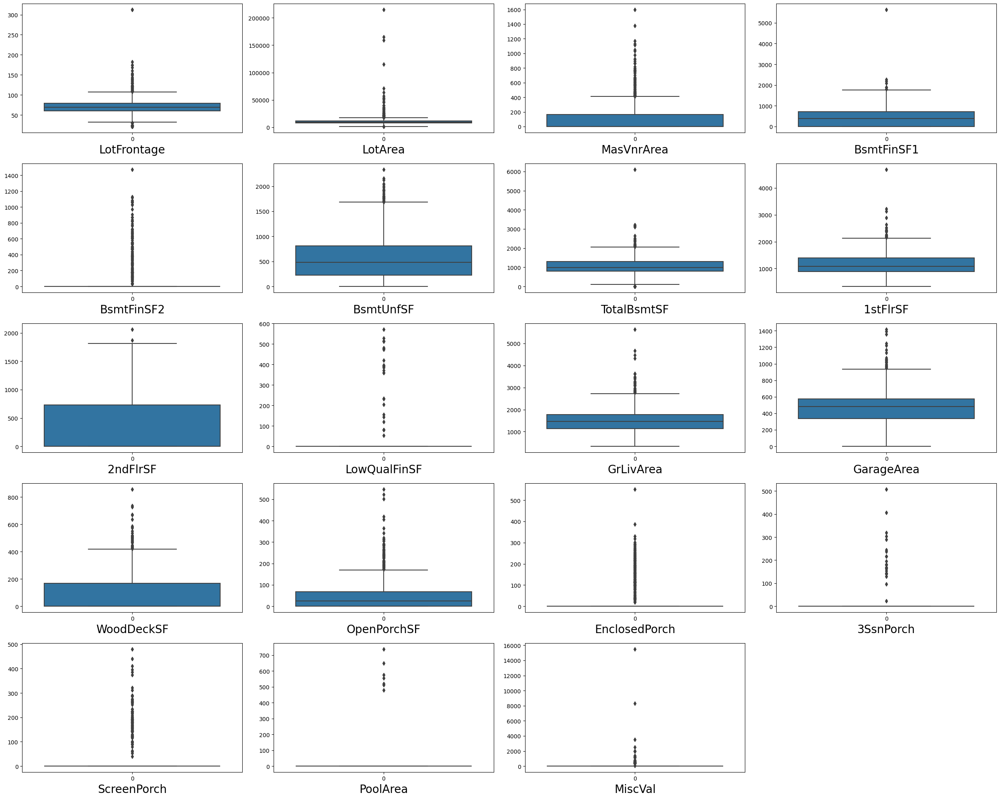

In [33]:
plt.figure(figsize=(25,20))  # checking outliers 
plt_num=1
for column in continues_col:
    if(plt_num<=81):
        plt.subplot(5,4,plt_num)
        sb.boxplot(df[column]) # create boxplot
        plt.xlabel(column,fontsize=20)
    plt_num+=1
plt.tight_layout()

Here we can see that there are many continues columns that have outliers but here we don't remove all column's outliers beacause of Some outliers may represent valid, rare, but important instances, such as luxury homes with large values for features like GrLivArea or LotArea. Removing these could result in loss of valuable information.

Columns in which we remove outliers:- \
 --> LotFrontage\
 --> MasVnrArea\
 --> BsmtFinSF1\
 --> BsmtFinSF2\
 --> TotalBsmtSF\
 --> 1stFlrSF\
 --> 2ndFlrSF\
 --> GarageArea\
 --> WoodDeckSF\
 --> OpenPorchSF\
 --> EnclosedPorch\
 --> ScreenPorch\
 --> 3SsnPorch\
 --> PoolArea\
 --> MiscVal


<Axes: >

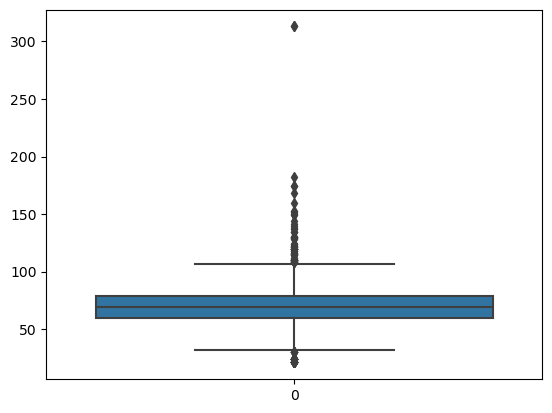

In [34]:
sb.boxplot(df.LotFrontage) #checking outliers

In [35]:
df.loc[df['LotFrontage']>155,'LotFrontage'] # find the outliers

197     174.0
231     174.0
934     313.0
1107    168.0
1127    182.0
1182    160.0
1298    313.0
Name: LotFrontage, dtype: float64

In [36]:
df.loc[df['LotFrontage']>155,'LotFrontage'] = df.LotFrontage.median()  # remove outliers with median

<Axes: >

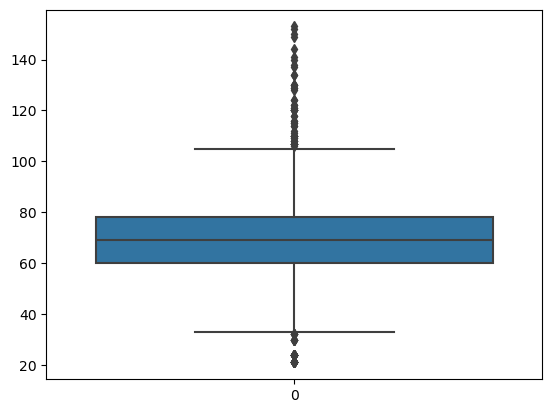

In [37]:
sb.boxplot(df.LotFrontage)

<Axes: >

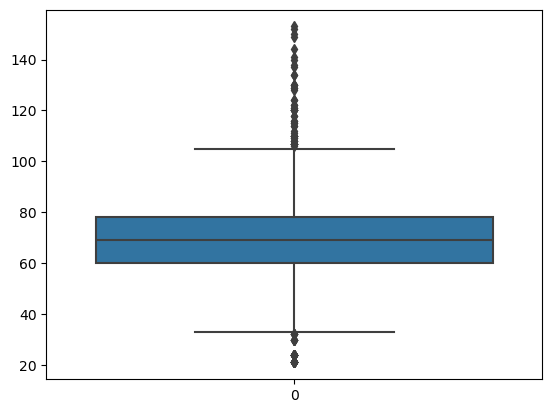

In [38]:
sb.boxplot(df.LotFrontage) #checking outliers

<Axes: >

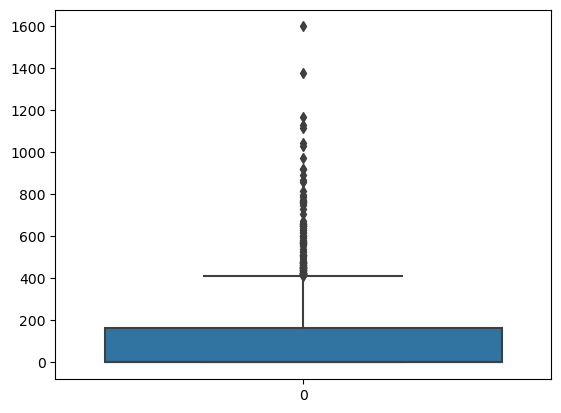

In [39]:
sb.boxplot(df.MasVnrArea) #checking outliers

In [40]:
df.loc[df['MasVnrArea']>850,'MasVnrArea'] # find the outliers

58      1031.0
70      1115.0
115     1129.0
224      922.0
297     1600.0
349      870.0
517      921.0
691     1170.0
755      894.0
798      860.0
808     1047.0
981      975.0
1169    1378.0
Name: MasVnrArea, dtype: float64

In [41]:
df.loc[df['MasVnrArea']>850,'MasVnrArea'] =df.MasVnrArea.median() # remove outliers with median

<Axes: >

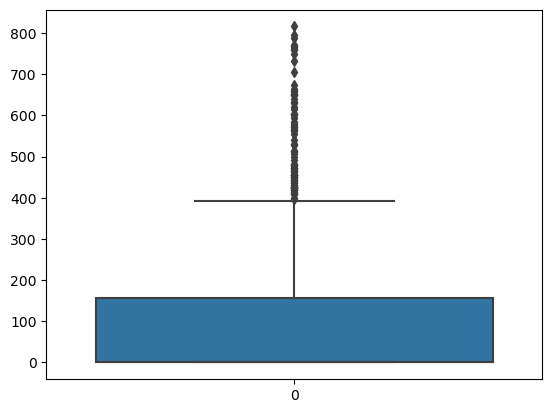

In [42]:
sb.boxplot(df.MasVnrArea) #checking outliers

<Axes: >

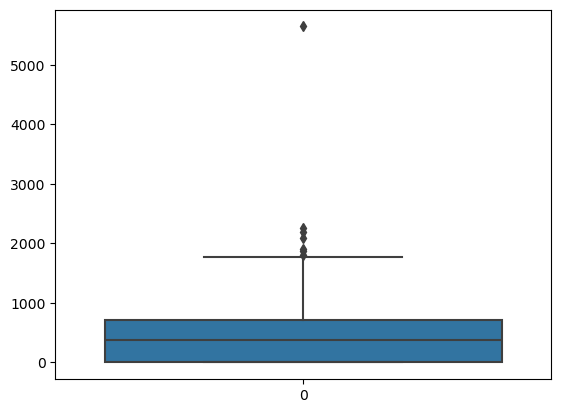

In [43]:
sb.boxplot(df.BsmtFinSF1) #checking outliers

In [44]:
df.loc[df['BsmtFinSF1']>2000,'BsmtFinSF1']  # find the outliers

523     2260
898     2188
1182    2096
1298    5644
Name: BsmtFinSF1, dtype: int64

In [45]:
df.loc[df['BsmtFinSF1']>2000,'BsmtFinSF1'] = df.BsmtFinSF1.median() # remove outliers with median

<Axes: >

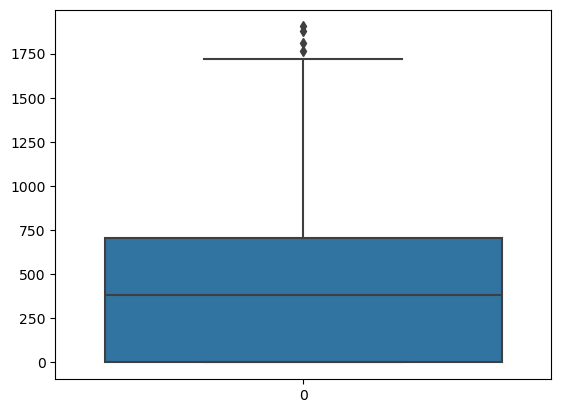

In [46]:
sb.boxplot(df.BsmtFinSF1) #checking outliers

<Axes: >

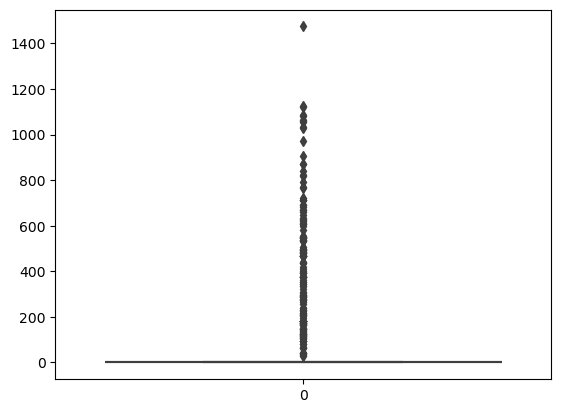

In [47]:
sb.boxplot(df.BsmtFinSF2)#checking outliers

In [48]:
df.loc[df['BsmtFinSF2']>1200,'BsmtFinSF2'] = df.BsmtFinSF2.median() # remove outliers with median

<Axes: >

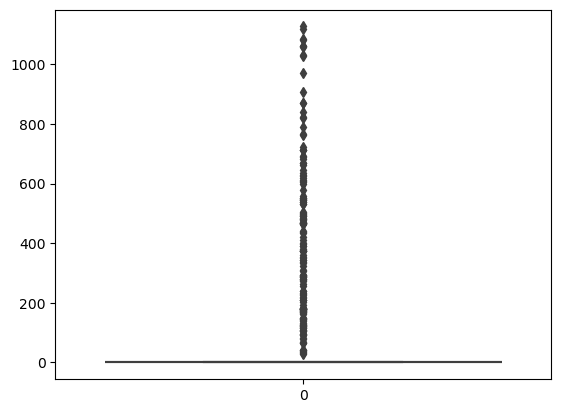

In [49]:
sb.boxplot(df.BsmtFinSF2) #checking outliers

In [50]:
df.loc[df['BsmtFinSF2']>850,'BsmtFinSF2'] = df.BsmtFinSF2.median() # remove outliers with median

<Axes: >

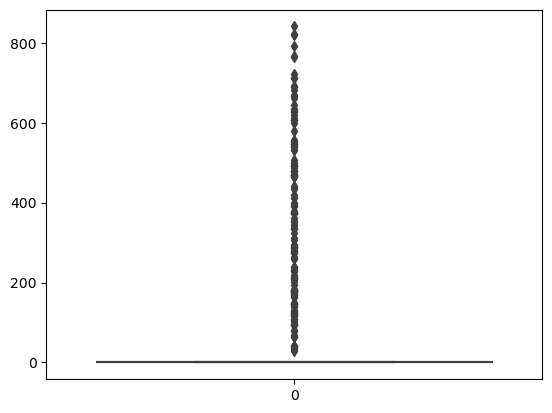

In [51]:
sb.boxplot(df.BsmtFinSF2) #checking outliers

<Axes: >

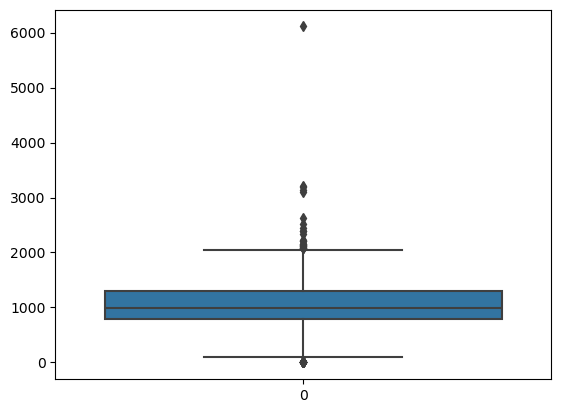

In [52]:
sb.boxplot(df.TotalBsmtSF) #checking outliers

In [53]:
df.loc[df['TotalBsmtSF']>3000,'TotalBsmtSF'] # find the outliers

332     3206
440     3094
496     3200
523     3138
1298    6110
Name: TotalBsmtSF, dtype: int64

In [54]:
df.loc[df['TotalBsmtSF']>3000,'TotalBsmtSF'] = df.TotalBsmtSF.median()

<Axes: >

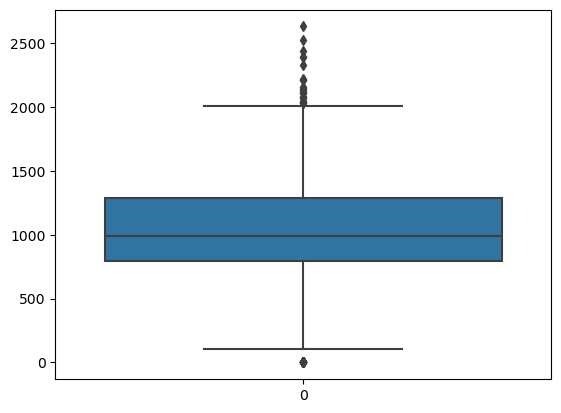

In [55]:
sb.boxplot(df.TotalBsmtSF) #checking outliers

<Axes: >

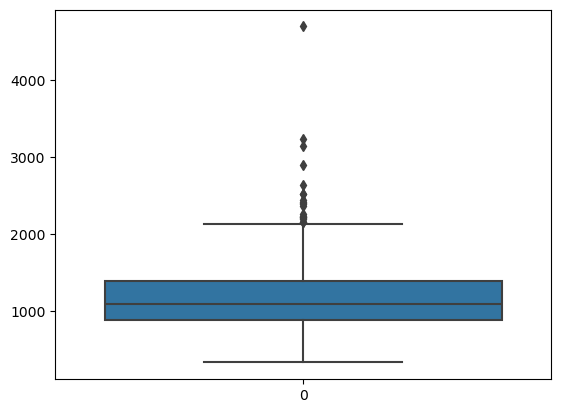

In [56]:
sb.boxplot(df['1stFlrSF']) #checking outliers

In [57]:
df.loc[df['1stFlrSF']>2800,'1stFlrSF'] # find the outliers

496     3228
523     3138
1024    2898
1298    4692
Name: 1stFlrSF, dtype: int64

In [58]:
df.loc[df['1stFlrSF']>2800,'1stFlrSF'] = df['1stFlrSF'].median() # remove outliers with median

<Axes: >

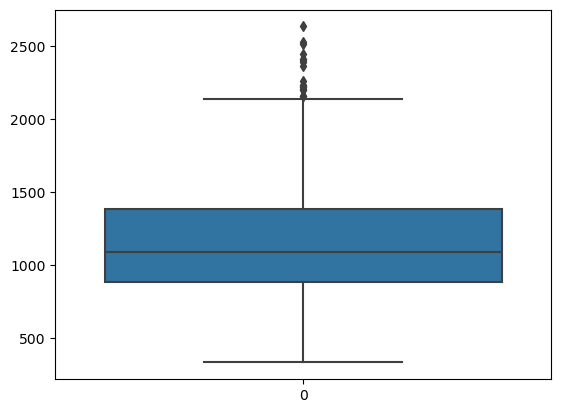

In [59]:
sb.boxplot(df['1stFlrSF']) #checking outliers

<Axes: >

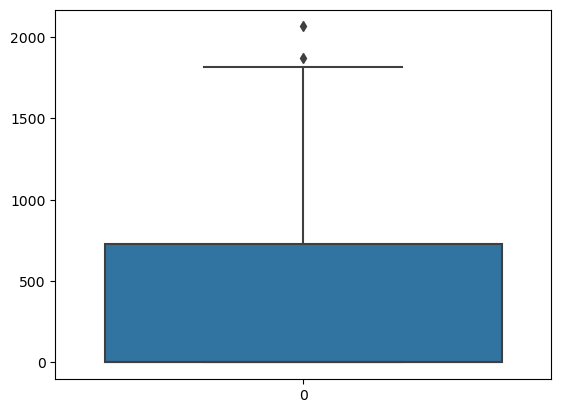

In [60]:
sb.boxplot(df['2ndFlrSF']) #checking outliers

In [61]:
df.loc[df['2ndFlrSF']>1850,'2ndFlrSF'] # find the outliers

691     1872
1182    2065
Name: 2ndFlrSF, dtype: int64

In [62]:
df.loc[df['2ndFlrSF']>1850,'2ndFlrSF'] =df['2ndFlrSF'].median() # remove outliers with median

<Axes: >

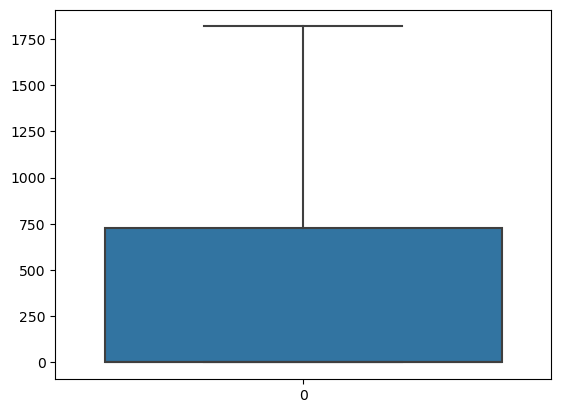

In [63]:
sb.boxplot(df['2ndFlrSF']) #checking outliers

<Axes: >

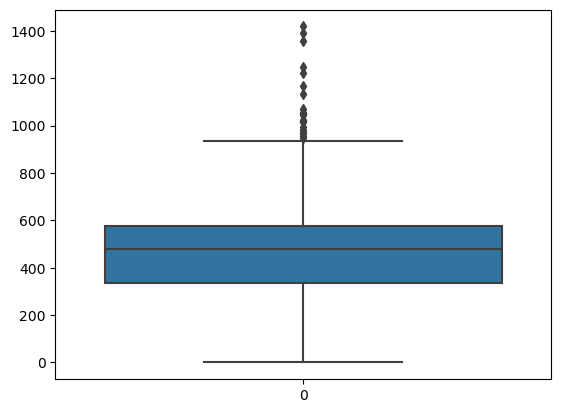

In [64]:
sb.boxplot(df.GarageArea) #checking outliers

In [65]:
df.loc[df['GarageArea']>1100,'GarageArea'] # find the outliers

178     1166
581     1390
664     1134
825     1220
1061    1248
1190    1356
1298    1418
Name: GarageArea, dtype: int64

In [66]:
df.loc[df['GarageArea']>1100,'GarageArea'] = df.GarageArea.median() # remove outliers with median

<Axes: >

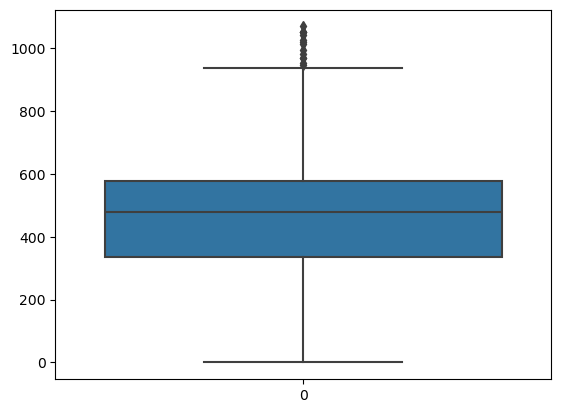

In [67]:
sb.boxplot(df.GarageArea) #checking outliers

<Axes: >

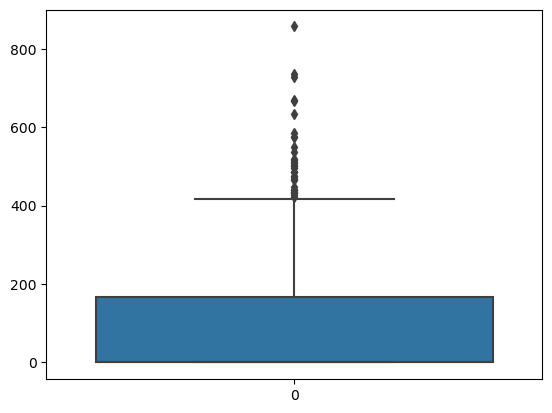

In [68]:
sb.boxplot(df.WoodDeckSF) #checking outliers

In [69]:
df.loc[df.WoodDeckSF>600,'WoodDeckSF'] # find the outliers

53      857
335     670
1068    728
1210    635
1313    668
1459    736
Name: WoodDeckSF, dtype: int64

In [70]:
df.loc[df.WoodDeckSF>600,'WoodDeckSF'] = df.WoodDeckSF.median() # remove outliers with median

<Axes: >

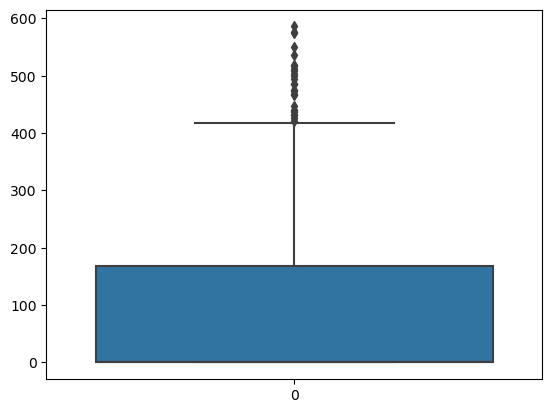

In [71]:
sb.boxplot(df.WoodDeckSF) #checking outliers

<Axes: >

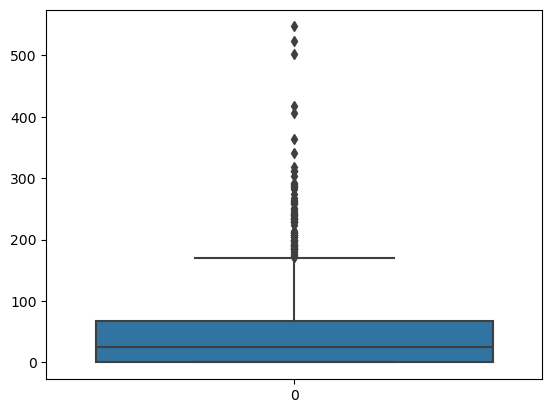

In [72]:
sb.boxplot(df.OpenPorchSF) #checking outliers

In [73]:
df.loc[df.OpenPorchSF>330,'OpenPorchSF'] # find the outliers

495     523
523     406
583     502
735     341
854     418
875     364
1328    547
Name: OpenPorchSF, dtype: int64

In [74]:
df.loc[df.OpenPorchSF>330,'OpenPorchSF'] = df.OpenPorchSF.median() # remove outliers with median

<Axes: >

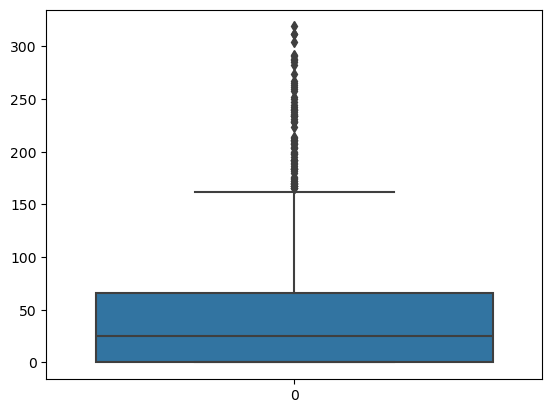

In [75]:
sb.boxplot(df.OpenPorchSF) #checking outliers

<Axes: >

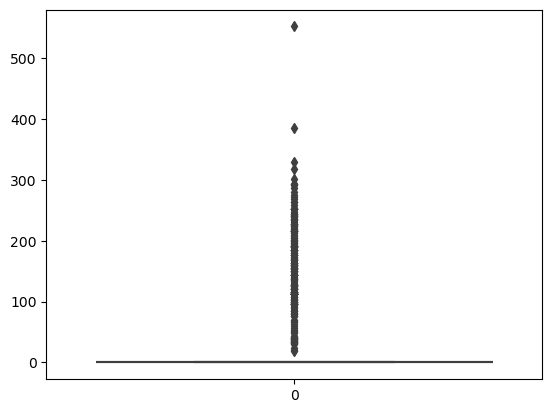

In [76]:
sb.boxplot(df.EnclosedPorch) #checking outliers

In [77]:
df.loc[df.EnclosedPorch>350,'EnclosedPorch'] # find the outliers

197    552
747    386
Name: EnclosedPorch, dtype: int64

In [78]:
df.loc[df.EnclosedPorch>350,'EnclosedPorch'] =df.EnclosedPorch.median() # remove outliers with median

<Axes: >

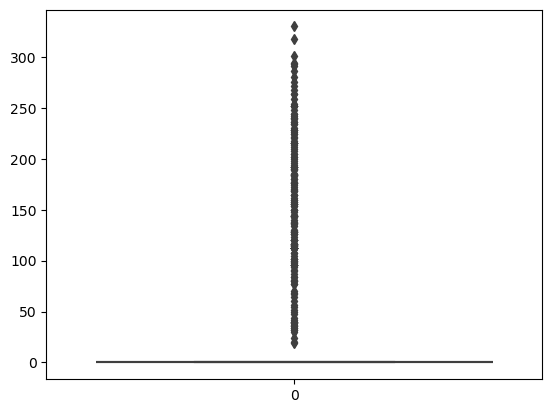

In [79]:
sb.boxplot(df.EnclosedPorch) #checking outliers

<Axes: >

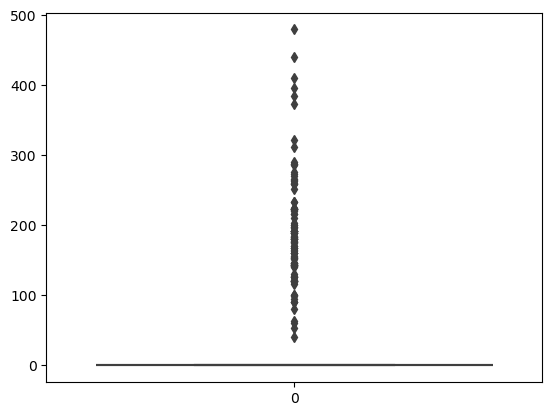

In [80]:
sb.boxplot(df.ScreenPorch) #checking outliers

In [81]:
df.loc[df.ScreenPorch> 350,'ScreenPorch'] # find the outliers

185     410
359     374
426     396
625     385
1328    480
1386    440
Name: ScreenPorch, dtype: int64

In [82]:
df.loc[df.ScreenPorch> 350,'ScreenPorch'] = df.ScreenPorch.median() # remove outliers with median

<Axes: >

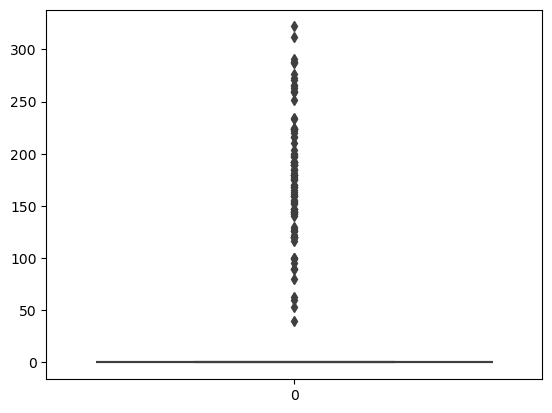

In [83]:
sb.boxplot(df.ScreenPorch) #checking outliers

<Axes: >

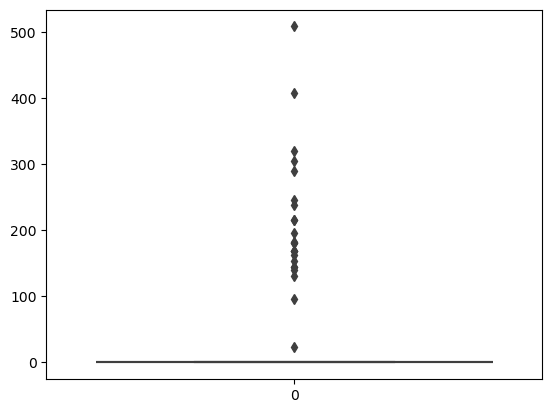

In [84]:
sb.boxplot(df['3SsnPorch']) #checking outliers

In [85]:
df.loc[df['3SsnPorch']>400,'3SsnPorch'] # find the outliers

55     407
205    508
Name: 3SsnPorch, dtype: int64

In [86]:
df.loc[df['3SsnPorch']>400,'3SsnPorch'] = df['3SsnPorch'].median() # remove outliers with median

<Axes: >

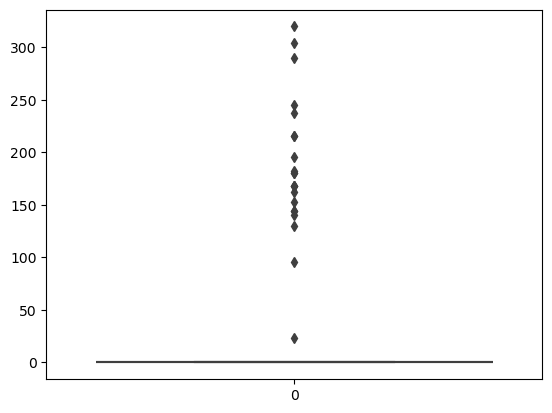

In [87]:
sb.boxplot(df['3SsnPorch']) #checking outliers

<Axes: >

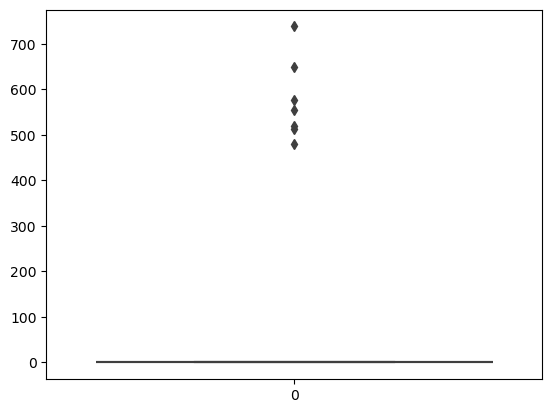

In [88]:
sb.boxplot(df.PoolArea) #checking outliers

In [89]:
df.loc[df.PoolArea>600,'PoolArea'] # find the outliers

810     648
1423    738
Name: PoolArea, dtype: int64

In [90]:
df.loc[df.PoolArea>600,'PoolArea'] = df.PoolArea.median() # remove outliers with median

<Axes: >

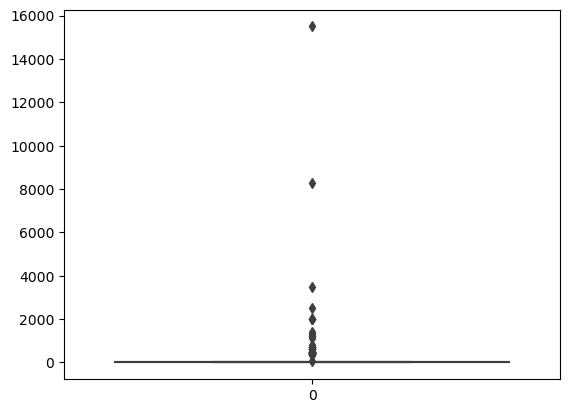

In [91]:
sb.boxplot(df.MiscVal) #checking outliers

In [92]:
df.loc[df.MiscVal>2000,'MiscVal']  # find the outliers

346     15500
705      3500
1230     8300
1457     2500
Name: MiscVal, dtype: int64

In [93]:
df.loc[df.MiscVal>2000,'MiscVal'] = df.MiscVal.median() # remove outliers with median

<Axes: >

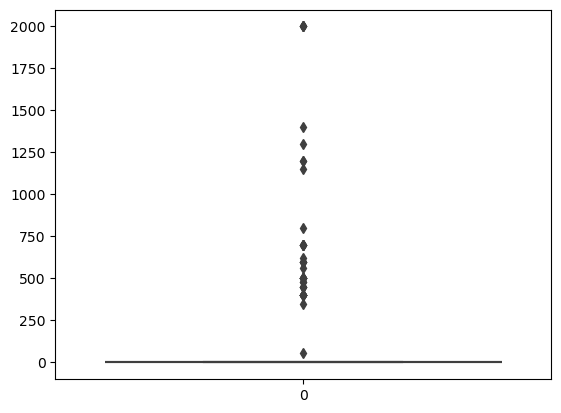

In [94]:
sb.boxplot(df.MiscVal) #checking outliers

### Now convert categorical data into numerical

So basically we have some columns which has data into categorical. So, we have to change that into numerical. Because our machine don't understand categorical data.

- To convert categorical data into numerical we have some technique which are,
1. Label Encoder
2. Ordinal Encoder
3. One Hot Encoder

In [95]:
object=[]  #creating lsit for categorical columns
for i in df:
    if(df[i].dtype == 'object'):
        object.append(i)

In [96]:
object

['MSZoning',
 'Street',
 'LotShape',
 'LandContour',
 'Utilities',
 'LotConfig',
 'LandSlope',
 'Neighborhood',
 'Condition1',
 'Condition2',
 'BldgType',
 'HouseStyle',
 'RoofStyle',
 'RoofMatl',
 'Exterior1st',
 'Exterior2nd',
 'ExterQual',
 'ExterCond',
 'Foundation',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'BsmtFinType1',
 'BsmtFinType2',
 'Heating',
 'HeatingQC',
 'CentralAir',
 'Electrical',
 'KitchenQual',
 'Functional',
 'GarageType',
 'GarageFinish',
 'GarageQual',
 'GarageCond',
 'PavedDrive',
 'SaleType',
 'SaleCondition']

In [97]:
for i in object:  #showing unique valeus number and unique values 
    print('Values:-{} ({}) \n {} \n'.format(i,len(df[i].unique()),df[i].unique()))

Values:-MSZoning (5) 
 ['RL' 'RM' 'C (all)' 'FV' 'RH'] 

Values:-Street (2) 
 ['Pave' 'Grvl'] 

Values:-LotShape (4) 
 ['Reg' 'IR1' 'IR2' 'IR3'] 

Values:-LandContour (4) 
 ['Lvl' 'Bnk' 'Low' 'HLS'] 

Values:-Utilities (2) 
 ['AllPub' 'NoSeWa'] 

Values:-LotConfig (5) 
 ['Inside' 'FR2' 'Corner' 'CulDSac' 'FR3'] 

Values:-LandSlope (3) 
 ['Gtl' 'Mod' 'Sev'] 

Values:-Neighborhood (25) 
 ['CollgCr' 'Veenker' 'Crawfor' 'NoRidge' 'Mitchel' 'Somerst' 'NWAmes'
 'OldTown' 'BrkSide' 'Sawyer' 'NridgHt' 'NAmes' 'SawyerW' 'IDOTRR'
 'MeadowV' 'Edwards' 'Timber' 'Gilbert' 'StoneBr' 'ClearCr' 'NPkVill'
 'Blmngtn' 'BrDale' 'SWISU' 'Blueste'] 

Values:-Condition1 (9) 
 ['Norm' 'Feedr' 'PosN' 'Artery' 'RRAe' 'RRNn' 'RRAn' 'PosA' 'RRNe'] 

Values:-Condition2 (8) 
 ['Norm' 'Artery' 'RRNn' 'Feedr' 'PosN' 'PosA' 'RRAn' 'RRAe'] 

Values:-BldgType (5) 
 ['1Fam' '2fmCon' 'Duplex' 'TwnhsE' 'Twnhs'] 

Values:-HouseStyle (8) 
 ['2Story' '1Story' '1.5Fin' '1.5Unf' 'SFoyer' 'SLvl' '2.5Unf' '2.5Fin'] 

Values:-Roof

In [98]:
# drop columns which have more than 15 unique values
df.drop('Neighborhood',axis=1,inplace=True)
df.drop('Exterior1st',axis=1,inplace=True)
df.drop('Exterior2nd',axis=1,inplace=True)

#### Label encoder

In [99]:
# create list for some featrures in which we use label encoder
label = ['MSZoning','Street','LotShape','LandContour','Utilities','LotConfig','LandSlope','Condition1','Condition2','BldgType',
        'HouseStyle','RoofStyle','RoofMatl','Foundation','BsmtFinType1','BsmtFinType2','Heating','Electrical','GarageType','GarageFinish',
        'SaleType','SaleCondition','CentralAir','PavedDrive']

#### Reason for using label Encoder:-
* Label Encoding was chosen for the following features because they represent categorical variables with ordinal or non-ordinal values that are either binary or have a manageable number of unique categories. Using Label Encoding converts these categories into numerical representations efficiently, which allows machine learning algorithms that expect numeric input to process them correctly. Since these features don't  require complex encoding (like one-hot encoding), and their unique values are limited, Label Encoding was an appropriate choice.

In [100]:
from sklearn.preprocessing import LabelEncoder  #label encoder
lb = LabelEncoder()

In [101]:
for i in label:
    df[i] =lb.fit_transform(df[i])  # here we are tranforming categorical data into numerical using label encoder

In [102]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,2003,2003,1,1,196.0,Gd,TA,2,Gd,TA,No,2,706.0,5,0,150,856.0,1,Ex,1,4,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,1,2003.0,1,2,548,TA,TA,2,0,61,0,0,0,0,0,2,2008,8,4,208500
1,2,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1976,1976,1,1,0.0,TA,TA,1,Gd,TA,Gd,0,978.0,5,0,284,1262.0,1,Ex,1,4,1262,0,0,1262,0,1,2,0,3,1,TA,6,Typ,1,1,1976.0,1,2,460,TA,TA,2,298,0,0,0,0,0,0,5,2007,8,4,181500
2,3,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,2001,2002,1,1,162.0,Gd,TA,2,Gd,TA,Mn,2,486.0,5,0,434,920.0,1,Ex,1,4,920,866,0,1786,1,0,2,1,3,1,Gd,6,Typ,1,1,2001.0,1,2,608,TA,TA,2,0,42,0,0,0,0,0,9,2008,8,4,223500
3,4,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1915,1970,1,1,0.0,TA,TA,0,TA,Gd,No,0,216.0,5,0,540,756.0,1,Gd,1,4,961,756,0,1717,1,0,1,0,3,1,Gd,7,Typ,1,5,1998.0,2,3,642,TA,TA,2,0,35,272,0,0,0,0,2,2006,8,0,140000
4,5,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,2000,2000,1,1,350.0,Gd,TA,2,Gd,TA,Av,2,655.0,5,0,490,1145.0,1,Ex,1,4,1145,1053,0,2198,1,0,2,1,4,1,Gd,9,Typ,1,1,2000.0,1,3,836,TA,TA,2,192,84,0,0,0,0,0,12,2008,8,4,250000


#### Ordinal Encoder

In [103]:
Ordinal=['ExterQual','ExterCond','BsmtQual','BsmtCond',
         'BsmtExposure','HeatingQC','KitchenQual','Functional',
         'GarageQual','GarageCond',]   #Creating variable for that columns in which we apply Ordinal encoding

#### Reason for using Ordinal Encoder:-
* Ordinal Encoding was used for these features because they represent categorical variables with a natural ordering or hierarchy. Each category reflects a level of quality or condition (e.g., Excellent, Good, Fair, Poor), which implies an ordinal relationship between the values. By using Ordinal Encoding, we preserve the ranking between categories while converting them into numerical values, ensuring that the model can understand the progression in quality or condition.

In [104]:
from sklearn.preprocessing import OrdinalEncoder #applying ordinal encoding

In [105]:
Ordinal

['ExterQual',
 'ExterCond',
 'BsmtQual',
 'BsmtCond',
 'BsmtExposure',
 'HeatingQC',
 'KitchenQual',
 'Functional',
 'GarageQual',
 'GarageCond']

In [106]:
for i in Ordinal:  #getting unique values for ordinal encoding
    print(' {} ({}) {} '.format(i,len(df[i].unique()),df[i].unique()))

 ExterQual (4) ['Gd' 'TA' 'Ex' 'Fa'] 
 ExterCond (5) ['TA' 'Gd' 'Fa' 'Po' 'Ex'] 
 BsmtQual (4) ['Gd' 'TA' 'Ex' 'Fa'] 
 BsmtCond (4) ['TA' 'Gd' 'Fa' 'Po'] 
 BsmtExposure (4) ['No' 'Gd' 'Mn' 'Av'] 
 HeatingQC (5) ['Ex' 'Gd' 'TA' 'Fa' 'Po'] 
 KitchenQual (4) ['Gd' 'TA' 'Ex' 'Fa'] 
 Functional (7) ['Typ' 'Min1' 'Maj1' 'Min2' 'Mod' 'Maj2' 'Sev'] 
 GarageQual (5) ['TA' 'Fa' 'Gd' 'Ex' 'Po'] 
 GarageCond (5) ['TA' 'Fa' 'Gd' 'Po' 'Ex'] 


In [107]:
order = [
    ['Fa', 'TA', 'Gd', 'Ex'],  # ExterQual
    ['Po','Fa', 'TA', 'Gd', 'Ex'],  # ExterCond
    ['Fa', 'TA', 'Gd', 'Ex'],  # BsmtQual
    ['Po','Fa', 'TA', 'Gd'],  # BsmtCond
    ['No', 'Mn', 'Av', 'Gd'],  # BsmtExposure
    ['Po', 'Fa', 'TA', 'Gd', 'Ex'],  # HeatingQC
    ['Fa', 'TA', 'Gd', 'Ex'],  # KitchenQual
    ['Sev', 'Maj2', 'Maj1', 'Min2', 'Min1', 'Mod', 'Typ'],  # Functional
    ['Po','Fa', 'TA', 'Gd', 'Ex'],  # GarageQual
    ['Po','Fa', 'TA', 'Gd', 'Ex']  # GarageCond
]  # here we are defining order

In [108]:
encoder=OrdinalEncoder(categories=order,dtype=int) # call the encoder

In [109]:
df[Ordinal] = encoder.fit_transform(df[Ordinal]) # here we are transforming our data in numerical

In [110]:
df.head() # showing the first 5 data row

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,2003,2003,1,1,196.0,2,2,2,2,2,0,2,706.0,5,0,150,856.0,1,4,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,2003.0,1,2,548,2,2,2,0,61,0,0,0,0,0,2,2008,8,4,208500
1,2,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1976,1976,1,1,0.0,1,2,1,2,2,3,0,978.0,5,0,284,1262.0,1,4,1,4,1262,0,0,1262,0,1,2,0,3,1,1,6,6,1,1,1976.0,1,2,460,2,2,2,298,0,0,0,0,0,0,5,2007,8,4,181500
2,3,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,2001,2002,1,1,162.0,2,2,2,2,2,1,2,486.0,5,0,434,920.0,1,4,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,1,2001.0,1,2,608,2,2,2,0,42,0,0,0,0,0,9,2008,8,4,223500
3,4,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1915,1970,1,1,0.0,1,2,0,1,3,0,0,216.0,5,0,540,756.0,1,3,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,5,1998.0,2,3,642,2,2,2,0,35,272,0,0,0,0,2,2006,8,0,140000
4,5,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,2000,2000,1,1,350.0,2,2,2,2,2,2,2,655.0,5,0,490,1145.0,1,4,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,1,2000.0,1,3,836,2,2,2,192,84,0,0,0,0,0,12,2008,8,4,250000


In [111]:
df.info() # used for dataset information

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 72 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   int32  
 3   LotFrontage    1460 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   int32  
 6   LotShape       1460 non-null   int32  
 7   LandContour    1460 non-null   int32  
 8   Utilities      1460 non-null   int32  
 9   LotConfig      1460 non-null   int32  
 10  LandSlope      1460 non-null   int32  
 11  Condition1     1460 non-null   int32  
 12  Condition2     1460 non-null   int32  
 13  BldgType       1460 non-null   int32  
 14  HouseStyle     1460 non-null   int32  
 15  OverallQual    1460 non-null   int64  
 16  OverallCond    1460 non-null   int64  
 17  YearBuilt      1460 non-null   int64  
 18  YearRemo

## Now handle year and month columns

In [112]:
time_col=['YearBuilt','YearRemodAdd','MoSold','YrSold','GarageYrBlt']  #Creating new variable for time realated columns

In [113]:
time_col

['YearBuilt', 'YearRemodAdd', 'MoSold', 'YrSold', 'GarageYrBlt']

* YrSold and MoSold these columns represent the year and month when the house was sold.
* Now compute the time difference btw YearBuilt, YrSold, YearRemodAdd to calculate the age of the hosue when is was sold or time since the last remodel.This is often more information thanjust the raw sale year.

In [114]:

df['HouseAgeAtSale'] = df['YrSold'] - df['YearBuilt'] # Time btw year bulit and year sold
df['RemodAgeAtSale'] = df['YrSold'] - df['YearRemodAdd'] # Time since last remdoel

In [115]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale
0,1,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,2003,2003,1,1,196.0,2,2,2,2,2,0,2,706.0,5,0,150,856.0,1,4,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,2003.0,1,2,548,2,2,2,0,61,0,0,0,0,0,2,2008,8,4,208500,5,5
1,2,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1976,1976,1,1,0.0,1,2,1,2,2,3,0,978.0,5,0,284,1262.0,1,4,1,4,1262,0,0,1262,0,1,2,0,3,1,1,6,6,1,1,1976.0,1,2,460,2,2,2,298,0,0,0,0,0,0,5,2007,8,4,181500,31,31
2,3,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,2001,2002,1,1,162.0,2,2,2,2,2,1,2,486.0,5,0,434,920.0,1,4,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,1,2001.0,1,2,608,2,2,2,0,42,0,0,0,0,0,9,2008,8,4,223500,7,6
3,4,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1915,1970,1,1,0.0,1,2,0,1,3,0,0,216.0,5,0,540,756.0,1,3,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,5,1998.0,2,3,642,2,2,2,0,35,272,0,0,0,0,2,2006,8,0,140000,91,36
4,5,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,2000,2000,1,1,350.0,2,2,2,2,2,2,2,655.0,5,0,490,1145.0,1,4,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,1,2000.0,1,3,836,2,2,2,192,84,0,0,0,0,0,12,2008,8,4,250000,8,8


* GarageYrBlt: This column represent the year the gerage was built.similer to the house's build year.

In [116]:
df['GarageAgeAtSale'] = df['YrSold'] - df['GarageYrBlt'] # time between year sold and garage year

In [117]:
df.head()

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
0,1,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,2003,2003,1,1,196.0,2,2,2,2,2,0,2,706.0,5,0,150,856.0,1,4,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,2003.0,1,2,548,2,2,2,0,61,0,0,0,0,0,2,2008,8,4,208500,5,5,5.0
1,2,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1976,1976,1,1,0.0,1,2,1,2,2,3,0,978.0,5,0,284,1262.0,1,4,1,4,1262,0,0,1262,0,1,2,0,3,1,1,6,6,1,1,1976.0,1,2,460,2,2,2,298,0,0,0,0,0,0,5,2007,8,4,181500,31,31,31.0
2,3,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,2001,2002,1,1,162.0,2,2,2,2,2,1,2,486.0,5,0,434,920.0,1,4,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,1,2001.0,1,2,608,2,2,2,0,42,0,0,0,0,0,9,2008,8,4,223500,7,6,7.0
3,4,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1915,1970,1,1,0.0,1,2,0,1,3,0,0,216.0,5,0,540,756.0,1,3,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,5,1998.0,2,3,642,2,2,2,0,35,272,0,0,0,0,2,2006,8,0,140000,91,36,8.0
4,5,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,2000,2000,1,1,350.0,2,2,2,2,2,2,2,655.0,5,0,490,1145.0,1,4,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,1,2000.0,1,3,836,2,2,2,192,84,0,0,0,0,0,12,2008,8,4,250000,8,8,8.0


In [118]:
df.drop(['YrSold','GarageYrBlt','YearBuilt','YearRemodAdd'],axis=1,inplace=True)  # Removing columns 

In [119]:
df.drop('Id',axis=1,inplace=True)  # Removing Id column which indicate only index

In [120]:
df.head()  # showning first 5 rows

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
0,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,1,1,196.0,2,2,2,2,2,0,2,706.0,5,0,150,856.0,1,4,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,1,2,548,2,2,2,0,61,0,0,0,0,0,2,8,4,208500,5,5,5.0
1,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1,1,0.0,1,2,1,2,2,3,0,978.0,5,0,284,1262.0,1,4,1,4,1262,0,0,1262,0,1,2,0,3,1,1,6,6,1,1,1,2,460,2,2,2,298,0,0,0,0,0,0,5,8,4,181500,31,31,31.0
2,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,1,1,162.0,2,2,2,2,2,1,2,486.0,5,0,434,920.0,1,4,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,1,1,2,608,2,2,2,0,42,0,0,0,0,0,9,8,4,223500,7,6,7.0
3,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1,1,0.0,1,2,0,1,3,0,0,216.0,5,0,540,756.0,1,3,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,5,2,3,642,2,2,2,0,35,272,0,0,0,0,2,8,0,140000,91,36,8.0
4,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,1,1,350.0,2,2,2,2,2,2,2,655.0,5,0,490,1145.0,1,4,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,1,1,3,836,2,2,2,192,84,0,0,0,0,0,12,8,4,250000,8,8,8.0


## Feature selection

**Feature Selection:-** Feature selection is the process of identifying and selecting the most relevant features in a dataset that contribute significantly to a model's performance. It helps reduce dimensionality, improve model accuracy, and minimize overfitting by eliminating irrelevant or redundant features. 

Here We know that in this data set there are 81 columns, so first we should apply Principal Component Analysis(PCA) to know that which components are more important for us to build model.

#### Principal Component Analysis(PCA):-
* Principal Component Analysis (PCA) is applied to reduce the dimensionality of the dataset when there are many features. By transforming the data into a smaller set of uncorrelated components, PCA helps in capturing the most important variance in the data while removing redundant or highly correlated features. This not only simplifies the model but also reduces the risk of overfitting. Additionally, PCA can improve the computational efficiency and performance of machine learning algorithms by lowering the complexity of the data. It's especially useful when dealing with multicollinearity among features.

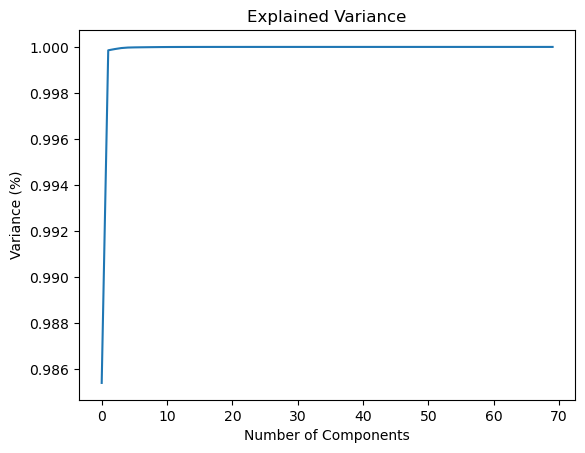

In [121]:
## getting the optimal number of pca
from sklearn.decomposition import PCA
pca = PCA()
principalComponents = pca.fit_transform(df)
plt.figure()
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('Number of Components')
plt.ylabel('Variance (%)') 
plt.title('Explained Variance')
plt.show()

* After applying PCA (Principal Component Analysis) on the house price prediction dataset, the scree plot reveals a steep upward trend from the beginning. This suggests that each component captures a significant amount of variance in the data. In other words, all features contribute valuable information and are important for building the model. As a result, reducing the dimensionality by eliminating components may not be beneficial, as it would lead to a loss of crucial information. Therefore, PCA indicates that most of the features should be retained to ensure better model performance.

In [122]:
correlation_matrix=df.corr() # calculation correlation matrix

In [123]:
for i in range(len(correlation_matrix.columns)):   # iterate over the correlation matrix and print coluns with correlation >0.50
    for j in range(i):
        if abs(correlation_matrix.iloc[i,j])>0.50:
            col1=correlation_matrix.columns[i]
            col2=correlation_matrix.columns[j]
            corr_value = correlation_matrix.iloc[i,j]
            print(f"Correlation between {col1} and {col2} : {corr_value:.2f}")

Correlation between BldgType and MSSubClass : 0.75
Correlation between ExterQual and OverallQual : 0.73
Correlation between BsmtQual and OverallQual : 0.67
Correlation between BsmtQual and ExterQual : 0.65
Correlation between BsmtQual and Foundation : 0.50
Correlation between BsmtFinSF1 and BsmtFinType1 : -0.60
Correlation between BsmtFinSF2 and BsmtFinType2 : -0.72
Correlation between BsmtUnfSF and BsmtFinSF1 : -0.52
Correlation between TotalBsmtSF and OverallQual : 0.53
Correlation between HeatingQC and ExterQual : 0.52
Correlation between 1stFlrSF and TotalBsmtSF : 0.80
Correlation between GrLivArea and OverallQual : 0.59
Correlation between GrLivArea and 1stFlrSF : 0.50
Correlation between GrLivArea and 2ndFlrSF : 0.66
Correlation between BsmtFullBath and BsmtFinSF1 : 0.66
Correlation between FullBath and OverallQual : 0.55
Correlation between FullBath and GrLivArea : 0.63
Correlation between HalfBath and 2ndFlrSF : 0.61
Correlation between BedroomAbvGr and GrLivArea : 0.52
Correla

#### Checking correlation between all features

In [124]:
df.corr() #checking correlation 

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
MSSubClass,1.000000,0.035900,-0.401467,-0.139781,-0.024969,0.119289,-0.002940,-0.022844,0.075910,-0.025672,-0.024762,-0.042395,0.746063,0.397161,0.032628,-0.059316,-0.117817,-0.031336,0.008168,0.016178,-0.064686,0.058126,0.076820,-0.005152,0.054925,0.016599,-0.072931,0.041195,-0.054713,-0.140759,-0.250598,0.048009,-0.019458,-0.101774,0.051945,-0.260957,0.310261,0.046474,0.074853,0.003491,-0.002333,0.131608,0.177354,-0.023438,0.281721,-0.012383,0.040380,0.005638,-0.045569,0.090719,0.012301,-0.040110,-0.101369,0.024439,-0.025864,-0.059925,-0.028192,-0.002708,-0.016671,-0.030822,-0.029861,0.014347,-0.046727,-0.013585,0.012464,-0.024940,-0.084284,-0.028746,-0.041968,-0.082451
MSZoning,0.035900,1.000000,-0.120034,-0.034452,0.087654,0.061887,-0.017854,-0.001192,-0.009895,-0.022055,-0.027874,0.044606,0.005690,-0.105315,-0.160099,0.186951,-0.000301,0.005133,-0.019794,-0.195689,0.091101,-0.235174,-0.209086,-0.051366,-0.016238,0.024688,-0.051570,-0.031718,0.039429,-0.046749,-0.094443,0.056866,-0.162866,-0.049523,-0.070818,-0.058083,-0.051671,0.011520,-0.082615,-0.018526,0.007193,-0.198290,-0.133876,-0.016471,0.049434,-0.160914,-0.043200,-0.092383,-0.011349,0.116007,0.167501,-0.157042,-0.183197,-0.089848,-0.069692,-0.100366,-0.015508,-0.153664,0.113526,0.001636,0.003572,-0.002664,0.011520,-0.031496,0.097437,0.009494,-0.166872,0.307520,0.173441,0.262217
LotFrontage,-0.401467,-0.120034,1.000000,0.272915,-0.045180,-0.147452,-0.027015,-0.000243,-0.170545,0.051836,-0.000789,0.004119,-0.453752,0.018412,0.214929,-0.054982,0.166493,0.054169,0.168941,0.152481,-0.021038,0.095195,0.148109,0.040751,0.143691,-0.017115,0.118367,-0.032708,0.062001,0.157038,0.313192,-0.018938,0.075445,0.067898,0.057588,0.367265,0.040172,0.017077,0.302545,0.054143,-0.015107,0.173150,0.043155,0.242211,0.001928,0.144999,0.302583,0.018323,0.214224,-0.236462,-0.212616,0.283562,0.310191,0.051750,0.035197,0.090820,0.091602,0.119304,-0.021449,0.050871,0.045915,0.010704,0.011505,0.006439,-0.031497,0.078103,0.335701,-0.118301,-0.063498,-0.063646
LotArea,-0.139781,-0.034452,0.272915,1.000000,-0.197131,-0.165315,-0.149083,0.010123,-0.121161,0.436868,0.023846,0.022164,-0.205721,-0.033190,0.105806,-0.005636,0.077054,0.149837,0.097137,0.055570,0.014732,-0.011081,0.079775,0.028160,0.232300,-0.061880,0.172091,-0.068954,0.116008,-0.002618,0.223697,0.028158,0.003581,0.049755,0.043856,0.267007,0.046507,0.004779,0.263116,0.158155,0.048046,0.126031,0.014259,0.119690,-0.017784,0.067864,0.190015,-0.018903,0.271364,-0.116799,-0.116326,0.154871,0.156449,0.026851,0.016833,0.015134,0.102809,0.077712,-0.029224,0.023468,0.036101,0.086371,0.086826,0.001205,0.012292,0.034169,0.263843,-0.014832,-0.014709,0.025036
Street,-0.024969,0.087654,-0.045180,-0.197131,1.000000,-0.010224,0.115995,0.001682,0.013960,-0.179360,-0.071657,0.002039,-0.018243,0.023704,0.058823,0.042848,-0.019732,0.008081,0.016023,0.100247,-0.015212,0.035277,0.021961,0.002478,-0.093411,-0.013182,-0.017763,0.061285,-0.054178,0.035229,0.004006,0.007904,0.043211,0.069869,0.021324,0.005143,0.047014,0.007724,0.044121,-0.050524,0.015485,0.046471,0.027628,0.028865,0.013583,0.065669,0.046828,-0.015996,-0.005348,0.001517,-0.008277,-0.020025,-0.010852,-0.006192,-0.006805,0.024521,0.039810,-0.0083

* Here we see that not any features are correlated each other more than 88%.

### Transformation

* It is a technique to convert skewed distribution to Normal distribution by applying Log, Sqrt(Squre Root), Box-cox, Inverse.

<Axes: xlabel='SalePrice', ylabel='Count'>

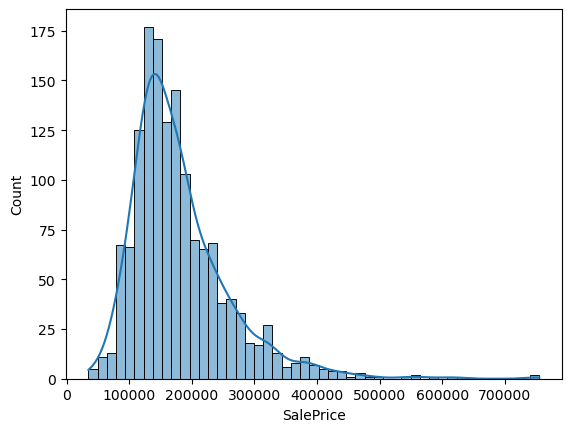

In [125]:
sb.histplot(df.SalePrice,kde=True) #show histo gram of sale price 

In [126]:
df['SalePrice'] = np.log(df['SalePrice'])  #Apply log to sale price column

<Axes: xlabel='SalePrice', ylabel='Count'>

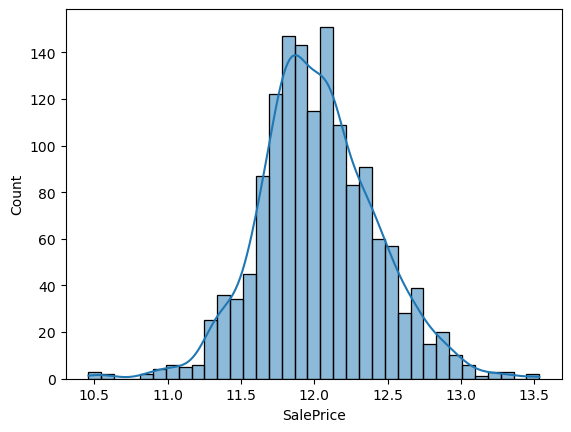

In [127]:
sb.histplot(df.SalePrice,kde=True) # showning histogram

* Log transformation was applied only to the SalePrice column because its distribution showed significant improvement after applying the transformation, making it more normally distributed. This helps stabilize variance and make the data more suitable for modeling. For other columns, I did not apply log transformation because their distributions did not show meaningful improvement or change after the transformation. Applying log in such cases would not have provided any added benefit for the model. Therefore, log transformation was selectively applied where it proved useful.

# Scaling

* Scaling is very important of continous features because some model give more priproty to that features which has higest values campare to another features. that's why we use Scaling to make all values into certain range.
 
* Basically there are 2 type of scaling.

1. MinMax Scaling
2. Standardization Scaling

* MinMax Scaling transform all data between 0 to 1  range.
* Standardization Scaling transform all data between -3 to +3 range. it use z-score to tranform data.

In [128]:
df.head() # showning the first 5 rows

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
0,60,3,65.0,8450,1,3,3,0,4,0,2,2,0,5,7,5,1,1,196.0,2,2,2,2,2,0,2,706.0,5,0,150,856.0,1,4,1,4,856,854,0,1710,1,0,2,1,3,1,2,8,6,0,1,1,2,548,2,2,2,0,61,0,0,0,0,0,2,8,4,12.247694,5,5,5.0
1,20,3,80.0,9600,1,3,3,0,2,0,1,2,0,2,6,8,1,1,0.0,1,2,1,2,2,3,0,978.0,5,0,284,1262.0,1,4,1,4,1262,0,0,1262,0,1,2,0,3,1,1,6,6,1,1,1,2,460,2,2,2,298,0,0,0,0,0,0,5,8,4,12.109011,31,31,31.0
2,60,3,68.0,11250,1,0,3,0,4,0,2,2,0,5,7,5,1,1,162.0,2,2,2,2,2,1,2,486.0,5,0,434,920.0,1,4,1,4,920,866,0,1786,1,0,2,1,3,1,2,6,6,1,1,1,2,608,2,2,2,0,42,0,0,0,0,0,9,8,4,12.317167,7,6,7.0
3,70,3,60.0,9550,1,0,3,0,0,0,2,2,0,5,7,5,1,1,0.0,1,2,0,1,3,0,0,216.0,5,0,540,756.0,1,3,1,4,961,756,0,1717,1,0,1,0,3,1,2,7,6,1,5,2,3,642,2,2,2,0,35,272,0,0,0,0,2,8,0,11.849398,91,36,8.0
4,60,3,84.0,14260,1,0,3,0,2,0,2,2,0,5,8,5,1,1,350.0,2,2,2,2,2,2,2,655.0,5,0,490,1145.0,1,4,1,4,1145,1053,0,2198,1,0,2,1,4,1,2,9,6,1,1,1,3,836,2,2,2,192,84,0,0,0,0,0,12,8,4,12.429216,8,8,8.0


In [129]:
original_col=df.columns #Store columns name in other variable

In [130]:
original_col

Index(['MSSubClass', 'MSZoning', 'LotFrontage', 'LotArea', 'Street',
       'LotShape', 'LandContour', 'Utilities', 'LotConfig', 'LandSlope',
       'Condition1', 'Condition2', 'BldgType', 'HouseStyle', 'OverallQual',
       'OverallCond', 'RoofStyle', 'RoofMatl', 'MasVnrArea', 'ExterQual',
       'ExterCond', 'Foundation', 'BsmtQual', 'BsmtCond', 'BsmtExposure',
       'BsmtFinType1', 'BsmtFinSF1', 'BsmtFinType2', 'BsmtFinSF2', 'BsmtUnfSF',
       'TotalBsmtSF', 'Heating', 'HeatingQC', 'CentralAir', 'Electrical',
       '1stFlrSF', '2ndFlrSF', 'LowQualFinSF', 'GrLivArea', 'BsmtFullBath',
       'BsmtHalfBath', 'FullBath', 'HalfBath', 'BedroomAbvGr', 'KitchenAbvGr',
       'KitchenQual', 'TotRmsAbvGrd', 'Functional', 'Fireplaces', 'GarageType',
       'GarageFinish', 'GarageCars', 'GarageArea', 'GarageQual', 'GarageCond',
       'PavedDrive', 'WoodDeckSF', 'OpenPorchSF', 'EnclosedPorch', '3SsnPorch',
       'ScreenPorch', 'PoolArea', 'MiscVal', 'MoSold', 'SaleType',
       'SaleConditi

#### Min-Max Scaling

* Here we apply Min-Max scaling because we want positive values.

In [131]:
# We apply min-max sacling
from sklearn.preprocessing import MinMaxScaler
scaler=MinMaxScaler()

In [132]:
df = scaler.fit_transform(df) #applying scaling to data

In [133]:
df= pd.DataFrame(df,columns=original_col)  #Give columns name after scaling

In [134]:
df.head() # showning the first 5 rows

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SaleType,SaleCondition,SalePrice,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
0,0.235294,0.75,0.333333,0.033420,1.0,1.0,1.0,0.0,1.0,0.0,0.250,0.285714,0.0,0.714286,0.666667,0.500,0.2,0.142857,0.240196,0.666667,0.5,0.4,0.666667,0.666667,0.000000,0.4,0.370798,1.0,0.0,0.064212,0.325104,0.2,1.00,1.0,1.0,0.227055,0.469747,0.0,0.259231,0.333333,0.0,0.666667,0.5,0.375,0.333333,0.666667,0.500000,1.0,0.000000,0.2,0.5,0.50,0.512629,0.5,0.5,1.0,0.000000,0.191223,0.000000,0.0,0.0,0.0,0.0,0.090909,1.0,0.8,0.581431,0.036765,0.098361,0.046729
1,0.000000,0.75,0.446970,0.038795,1.0,1.0,1.0,0.0,0.5,0.0,0.125,0.285714,0.0,0.285714,0.555556,0.875,0.2,0.142857,0.000000,0.333333,0.5,0.2,0.666667,0.666667,1.000000,0.0,0.513655,1.0,0.0,0.121575,0.479301,0.2,1.00,1.0,1.0,0.403654,0.000000,0.0,0.174830,0.000000,0.5,0.666667,0.0,0.375,0.333333,0.333333,0.333333,1.0,0.333333,0.2,0.5,0.50,0.430309,0.5,0.5,1.0,0.508532,0.000000,0.000000,0.0,0.0,0.0,0.0,0.363636,1.0,0.8,0.536319,0.227941,0.524590,0.289720
2,0.235294,0.75,0.356061,0.046507,1.0,0.0,1.0,0.0,1.0,0.0,0.250,0.285714,0.0,0.714286,0.666667,0.500,0.2,0.142857,0.198529,0.666667,0.5,0.4,0.666667,0.666667,0.333333,0.4,0.255252,1.0,0.0,0.185788,0.349411,0.2,1.00,1.0,1.0,0.254893,0.476348,0.0,0.273549,0.333333,0.0,0.666667,0.5,0.375,0.333333,0.666667,0.333333,1.0,0.333333,0.2,0.5,0.50,0.568756,0.5,0.5,1.0,0.000000,0.131661,0.000000,0.0,0.0,0.0,0.0,0.727273,1.0,0.8,0.604029,0.051471,0.114754,0.065421
3,0.294118,0.75,0.295455,0.038561,1.0,0.0,1.0,0.0,0.0,0.0,0.250,0.285714,0.0,0.714286,0.666667,0.500,0.2,0.142857,0.000000,0.333333,0.5,0.0,0.333333,1.000000,0.000000,0.0,0.113445,1.0,0.0,0.231164,0.287125,0.2,0.75,1.0,1.0,0.272727,0.415842,0.0,0.260550,0.333333,0.0,0.333333,0.0,0.375,0.333333,0.666667,0.416667,1.0,0.333333,1.0,1.0,0.75,0.600561,0.5,0.5,1.0,0.000000,0.109718,0.824242,0.0,0.0,0.0,0.0,0.090909,1.0,0.0,0.451871,0.669118,0.606557,0.074766
4,0.235294,0.75,0.477273,0.060576,1.0,0.0,1.0,0.0,0.5,0.0,0.250,0.285714,0.0,0.714286,0.777778,0.500,0.2,0.142857,0.428922,0.666667,0.5,0.4,0.666667,0.666667,0.666667,0.4,0.344013,1.0,0.0,0.209760,0.434865,0.2,1.00,1.0,1.0,0.352762,0.579208,0.0,0.351168,0.333333,0.0,0.666667,0.5,0.500,0.333333,0.666667,0.583333,1.0,0.333333,0.2,0.5,0.75,0.782039,0.5,0.5,1.0,0.327645,0.263323,0.000000,0.0,0.0,0.0,0.0,1.000000,1.0,0.8,0.640477,0.058824,0.147541,0.074766


# Model selection Process

In [135]:
x=df.drop('SalePrice',axis=1) #create independent variable
y=df.SalePrice # create dependent variable

In [136]:
from sklearn.model_selection import train_test_split # import library for split the data

In [137]:
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.2,random_state=41)  # split the data

In [138]:
x_train # checking independent training data

,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,RoofStyle,RoofMatl,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,SaleType,SaleCondition,HouseAgeAtSale,RemodAgeAtSale,GarageAgeAtSale
1400,0.176471,1.00,0.219697,0.021968,1.0,1.000000,1.000000,0.0,0.00,0.0,0.250,0.285714,0.00,0.000000,0.555556,0.750,0.2,0.142857,0.000000,0.333333,0.50,0.0,0.333333,0.666667,0.000000,1.0,0.000000,1.0,0.000000,0.369007,0.327383,0.2,0.50,1.0,1.00,0.267943,0.114411,0.000000,0.155237,0.000000,0.0,0.333333,0.0,0.375,0.333333,0.333333,0.250000,1.000000,0.333333,0.6,0.5,0.25,0.194574,0.50,0.50,1.0,0.000000,0.000000,0.339394,0.000000,0.000000,0.000000,0.000,0.545455,1.000,0.8,0.580882,0.967213,0.738318
219,0.588235,0.75,0.166667,0.007993,1.0,1.000000,1.000000,0.0,1.00,0.0,0.250,0.285714,1.00,0.285714,0.666667,0.500,0.2,0.142857,0.019608,0.666667,0.50,0.4,0.666667,0.666667,0.666667,0.4,0.008403,1.0,0.000000,0.527397,0.473984,0.2,1.00,1.0,1.00,0.397564,0.000000,0.000000,0.172193,0.000000,0.0,0.666667,0.0,0.250,0.333333,0.666667,0.250000,1.000000,0.000000,0.2,0.0,0.50,0.409729,0.50,0.50,1.0,0.184300,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.181818,0.750,1.0,0.007353,0.016393,0.009346
143,0.000000,0.75,0.431818,0.042230,1.0,0.000000,1.000000,0.0,1.00,0.0,0.250,0.285714,0.00,0.285714,0.666667,0.500,0.2,0.142857,0.224265,0.666667,0.50,0.4,0.666667,0.666667,1.000000,0.4,0.356618,1.0,0.000000,0.347175,0.565894,0.2,1.00,1.0,1.00,0.507612,0.000000,0.000000,0.219857,0.333333,0.0,0.666667,0.0,0.375,0.333333,0.666667,0.333333,1.000000,0.000000,0.2,0.5,0.50,0.539757,0.50,0.50,1.0,0.245734,0.090909,0.000000,0.000000,0.000000,0.000000,0.000,0.454545,1.000,0.8,0.073529,0.180328,0.093458
839,0.176471,0.75,0.371212,0.048924,1.0,1.000000,1.000000,0.0,1.00,0.0,0.250,0.285714,0.00,0.000000,0.444444,0.625,0.2,0.142857,0.000000,0.333333,0.50,0.2,0.333333,0.666667,0.000000,0.2,0.184874,1.0,0.000000,0.178082,0.291682,0.2,1.00,1.0,1.00,0.188778,0.237624,0.000000,0.163150,0.000000,0.0,0.333333,0.0,0.375,0.333333,0.333333,0.333333,1.000000,0.000000,1.0,1.0,0.25,0.224509,0.50,0.50,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000,0.363636,1.000,0.8,0.455882,0.229508,0.579439
1402,0.000000,0.75,0.325758,0.025530,1.0,1.000000,1.000000,0.0,1.00,0.0,0.250,0.285714,0.00,0.285714,0.666667,0.500,0.2,0.142857,0.000000,0.666667,0.50,0.4,0.666667,1.000000,0.666667,1.0,0.000000,1.0,0.000000,0.550514,0.488416,0.2,1.00,1.0,1.00,0.417573,0.000000,0.000000,0.180859,0.000000,0.0,0.666667,0.0,0.250,0.333333,0.666667,0.333333,1.000000,0.333333,0.2,0.5,0.50,0.619270,0.50,0.50,1.0,0.286689,0.172414,0.000000,0.000000,0.000000,0.000000,0.000,0.545455,0.750,1.0,0.000000,0.016393,0.000000
716,0.294118,1.00,0.295455,0.044404,1.0,1.000000,0.000000,0.0,1.00,0.0,0.250,0.285714,0.00,0.714286,0.666667,0.875,0.2,0.142857,0.000000,0.333333,0.75,0.0,0.333333,0.666667,0.000000,1.0,0.000000,1.0,0.000000,0.307363,0.272693,0.2,1.00,1.0,1.00,0.540235,0.537954,0.000000,0.418237,0.000000,0.0,0.333333,0.5,0.375,0.333333,0.333333,0.500000,1.000000,0.000000,1.0,1.0,0.50,0.658559,0.50,0.50,0.5,0.000000,0.150470,0.433333,0.000000,0.000000,0.000000,0.000,0.545455,1.000,0.8,0.860294,0.163934,0.102804
578,0.823529,0.25,0.098485,0.010769,1.0,1.000000,1.000000,0.0,0.00,0.0,0.250,0.285714,1.00,0.714286,0.666667,0.500,0.2,0.142857,0.000000,0.666667,0.50,0.4,0.666667,0.666667,0.000000,1.0,0.000000,1.0,0.000000,0.294949,0.261679,0.2,1.00,1.0,1.00,0.16

In [139]:
y_train # checking dependent training data

1400    0.401728
219     0.509702
143     0.574333
839     0.429013
1402    0.557781
716     0.494289
578     0.465521
1143    0.269837
1385    0.416305
899     0.440041
1092    0.443635
211     0.544286
396     0.409760
236     0.543410
723     0.440041
241     0.374900
112     0.780058
1091    0.495307
193     0.427765
1318    0.671480
40      0.495307
333     0.579082
1112    0.427514
714     0.429013
334     0.554613
393     0.342422
845     0.516935
1418    0.412394
1343    0.528153
522     0.493267
847     0.436407
808     0.495205
1278    0.623107
301     0.661877
870     0.371943
208     0.673837
1003    0.444599
503     0.687632
195     0.471044
1335    0.510984
194     0.420170
153     0.620350
376     0.469947
1239    0.660534
1252    0.427765
1412    0.308150
474     0.641776
357     0.437623
645     0.459336
615     0.446010
1459    0.468846
1006    0.502346
758     0.532534
52      0.373425
56      0.519776
312     0.401457
746     0.621731
524     0.716428
360     0.4870

# Model creation

## Linear Regression Algorithm

In [140]:
from sklearn.linear_model import LinearRegression # import Linear regression model
LR=LinearRegression() #call the model

In [141]:
LR.fit(x_train,y_train) #train the model

LinearRegression()

In [142]:
y_preLR = LR.predict(x_test)  #predict the test data

In [143]:
from sklearn.metrics import r2_score,root_mean_squared_error # import libraryies for model evaluation

In [144]:
r1=r2_score(y_test,y_preLR) # chech model performance for testing data
r1

0.8962358642310565

In [145]:
R1=root_mean_squared_error(y_test,y_preLR)  # check root mean squared  error for testing data
R1

0.039719920591151814

In [146]:
y_trainLR=LR.predict(x_train) # predict the training data

In [147]:
r2_score(y_train,y_trainLR) #chech model performance for training data

0.909204209694198

In [148]:
root_mean_squared_error(y_train,y_trainLR) # check root mean squared  error for training data

0.03961317874767761

In [149]:
errorLR = y_test-y_preLR   # check the error value

In [150]:
errorLR

335    -0.026756
1074    0.001142
933    -0.012810
982    -0.047983
921    -0.032165
573     0.007458
446    -0.063323
896     0.056803
1429   -0.045853
1214    0.027714
1122    0.070396
127    -0.037672
536    -0.016932
1240    0.034191
1387   -0.078411
1174    0.039987
1183   -0.045511
280     0.003828
568     0.003696
609     0.011529
912    -0.017283
283     0.013131
556     0.003151
950    -0.023666
1274    0.027799
1200    0.086949
540    -0.035611
980    -0.040520
1106   -0.062504
1434    0.027131
152     0.018135
25      0.030245
599    -0.012742
911    -0.028665
315    -0.002705
215     0.010897
655    -0.043023
425    -0.039566
284    -0.002922
482    -0.023659
1142    0.017309
1139    0.073371
242    -0.047765
1088   -0.029966
1394    0.017514
721     0.014451
591    -0.004970
10      0.003331
187     0.045428
472     0.027681
789    -0.052580
1352    0.005916
787     0.000927
483     0.000119
908     0.007013
81     -0.047704
1426    0.025189
586     0.022628
370    -0.0127

<Axes: xlabel='SalePrice', ylabel='Count'>

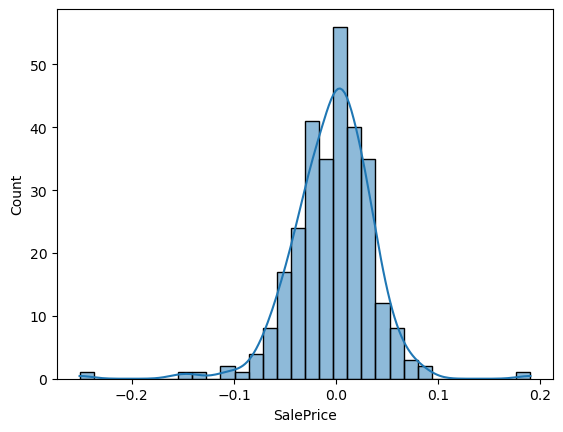

In [151]:
sb.histplot(errorLR,kde=True) # show the error value in plot

#### Conclusion:

* In Linear Regression R2_Score for testing data is **89.62%** and for training data is **90.92%** .
* RMSE for testing data is **0.03971** and for training data is **0.03961**.
* Here we can see that the linear regression model show **generalized** model.
* Error also show nearly normal distribution.


## SVM (Suport Vector Machine)

In [152]:
from sklearn.svm import SVR # import the svr algorithm
svr = SVR() # store svr algorithm
svr.fit(x_train,y_train) # train the model

SVR()

In [153]:
y_preSVR = svr.predict(x_test) # predict the testning data

In [154]:
r2_score(y_test,y_preSVR) # chech model performance for testing data

0.812531182437581

In [155]:
root_mean_squared_error(y_test,y_preSVR)  # check root mean squared  error for testing data

0.05338868880936626

In [156]:
y_trainSVR=svr.predict(x_train)  # predict the training data

In [157]:
r2_score(y_train,y_trainSVR)   # chech model performance for training data

0.8678562505222209

In [158]:
root_mean_squared_error(y_train,y_trainSVR) # check root mean squared  error for training data

0.047789242842893674

#### Now we apply Hyper-parameter Tuning.
**Hyper-parameter Tuning:-** 
Hyperparameter tuning is the process of optimizing model settings, like learning rate or number of estimators, to improve performance. It involves searching for the best combination of hyperparameters using methods like GridSearchCV or RandomizedSearchCV. The goal is to enhance accuracy and generalization on unseen data.

In [159]:
from sklearn.model_selection import RandomizedSearchCV # import Grid Search CV for hyper-parameter tuning

### Here are the reasons for using RandomizedSearchCV :

**Time Efficiency:-** RandomizedSearchCV explores a random subset of the hyperparameter space, making it much faster than GridSearchCV, especially when the search space is large. This is particularly helpful when tuning many parameters or having large datasets.

**Better Coverage:-** It can explore a broader range of hyperparameter values in a shorter amount of time since it samples randomly. This often leads to discovering better combinations of parameters that might be missed with the exhaustive approach of GridSearchCV.

**Computational Efficiency:-** With RandomizedSearchCV, you can specify the number of iterations (combinations) to try. This reduces the computational cost compared to GridSearchCV, which tests all possible combinations.

**Suitable for Large Parameter Space:-** In cases where there are many hyperparameters with a wide range of possible values, GridSearchCV becomes impractical due to the exponential growth in combinations. RandomizedSearchCV avoids this by sampling a fixed number of combinations.

In [160]:
# Define the hyperparameter grid

param_gridSVR = {
    'kernel': ['linear', 'poly', 'rbf'],         # Kernel type
    'C': [0.1, 1, 10, 100],                     # Regularization strength
    'gamma': ['scale', 'auto', 0.001, 0.01, 0.1, 1],  # Kernel coefficient
    'epsilon': [0.01, 0.1, 0.2, 0.5],           # Margin of tolerance
    'degree': [2, 3, 4]                         # Degree for 'poly' kernel
}


In [161]:
#  Random search on SVR with 5-fold cross-validation and 100 iterations, using R2 score
svr_grid= RandomizedSearchCV(estimator=svr,param_distributions=param_gridSVR, cv=5, scoring='r2', verbose=2, n_jobs=-1,n_iter=100,random_state=25)

In [162]:
svr_grid.fit(x_train,y_train)

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=SVR(), n_iter=100, n_jobs=-1,
                   param_distributions={'C': [0.1, 1, 10, 100],
                                        'degree': [2, 3, 4],
                                        'epsilon': [0.01, 0.1, 0.2, 0.5],
                                        'gamma': ['scale', 'auto', 0.001, 0.01,
                                                  0.1, 1],
                                        'kernel': ['linear', 'poly', 'rbf']},
                   random_state=25, scoring='r2', verbose=2)

In [163]:
y_hypsvr=svr_grid.predict(x_test) # predict the testning data

In [164]:
r2=r2_score(y_test,y_hypsvr) # check model performance for testing data
r2

0.9023055942239142

In [165]:
R2=root_mean_squared_error(y_test,y_hypsvr) # check root mean squared  error for testing data
R2

0.03854069861993848

In [166]:
y_trainhypsvr=svr_grid.predict(x_train) #predict the training data

In [167]:
r2_score(y_train,y_trainhypsvr) # check model performance for training data

0.9135404843567388

In [168]:
root_mean_squared_error(y_train,y_trainhypsvr)# check root mean squared  error for training data

0.0386556727658969

In [169]:
errorSVR=y_test-y_preSVR # check the error 

In [170]:
errorSVR

335     0.046915
1074    0.014291
933    -0.035940
982    -0.056473
921    -0.042056
573     0.004049
446    -0.088099
896     0.071450
1429   -0.081088
1214    0.031981
1122    0.053061
127    -0.065913
536    -0.052919
1240    0.022027
1387    0.005641
1174    0.103788
1183   -0.044242
280    -0.001564
568     0.029557
609     0.064345
912     0.043873
283     0.017508
556     0.007143
950    -0.041515
1274   -0.040745
1200    0.135785
540    -0.051142
980    -0.066911
1106   -0.144092
1434   -0.006044
152     0.020496
25      0.078262
599    -0.019596
911    -0.022161
315    -0.053106
215    -0.004150
655    -0.045654
425    -0.049541
284     0.019139
482    -0.085371
1142    0.035448
1139    0.074962
242    -0.040131
1088   -0.046274
1394   -0.028992
721    -0.014926
591     0.024250
10      0.028055
187     0.017774
472     0.002692
789    -0.064349
1352    0.041818
787     0.005510
483    -0.002890
908     0.014112
81     -0.054180
1426    0.025539
586     0.028550
370    -0.0093

<Axes: xlabel='SalePrice', ylabel='Count'>

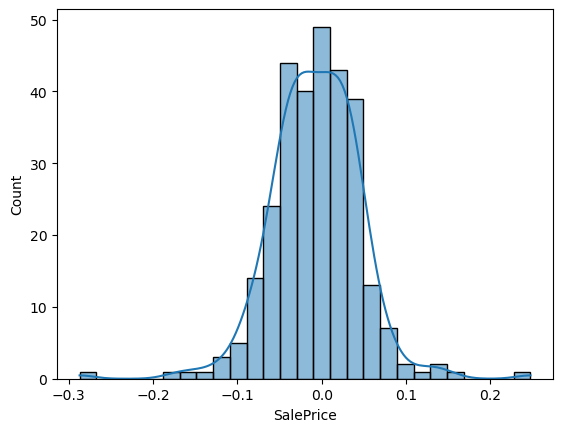

In [171]:
sb.histplot(errorSVR,kde=True) # show error on plot

#### Conclusion:-

* In SVM R2_Score after Hyper-parameter tuning for testing data is **90.23%** ~ 90% and for training data is **91.35%**.
* RMSE after Hyper-parameter tuning for testing data is **0.03854** and for training data is **0.03865**.
* Here we can see that the SVR model show Generalized model.
* Error also show Nearly normal distribution.

## Decision Tree

In [172]:
from sklearn.tree import DecisionTreeRegressor # import Decisiontree algorithm
DT = DecisionTreeRegressor(random_state=21) # call DT Algorithm
DT.fit(x_train,y_train) # train the model

DecisionTreeRegressor(random_state=21)

In [173]:
y_preDT = DT.predict(x_test) # predict the testing data

In [174]:
r2_score(y_test,y_preDT) # check model performance for testing data

0.7455571505748926

In [175]:
root_mean_squared_error(y_test,y_preDT) # check root mean squared  error for testing data

0.062198492687738034

In [176]:
y_trainDT = DT.predict(x_train) # predict training data

In [177]:
r2_score(y_train,y_trainDT)  ## check model performance for training  data

1.0

In [178]:
root_mean_squared_error(y_train,y_trainDT)

0.0

#### Now apply Hyper-Parameter Tuning

In [179]:
# Define hyperparameter grid
param_gridDTR = {
    'criterion': ['squared_error', 'absolute_error'],  # Function to measure the quality of a split
    'splitter': ['best', 'random'],  # Strategy used to split at each node
    'max_depth': [10, 20, 30, 40, 50],  # Maximum depth of the tree
    'min_samples_split': [1,2, 5],  # Minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4,5],  # Minimum number of samples required at a leaf node
    'max_features': ['sqrt', 'log2'],  # Number of features to consider when looking for the best split
    'max_leaf_nodes': [10, 20, 30, 50],  # Maximum number of leaf nodes in the tree
}

In [180]:
#  Random search on DTR with 5-fold cross-validation and 100 iterations, using R2 score
DT_grid = RandomizedSearchCV(estimator=DT,param_distributions=param_gridDTR, cv=5, scoring='r2', verbose=2, n_jobs=-1,n_iter=100,random_state=21)

In [181]:
DT_grid.fit(x_train,y_train) # train model

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=DecisionTreeRegressor(random_state=21),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'criterion': ['squared_error',
                                                      'absolute_error'],
                                        'max_depth': [10, 20, 30, 40, 50],
                                        'max_features': ['sqrt', 'log2'],
                                        'max_leaf_nodes': [10, 20, 30, 50],
                                        'min_samples_leaf': [1, 2, 4, 5],
                                        'min_samples_split': [1, 2, 5],
                                        'splitter': ['best', 'random']},
                   random_state=21, scoring='r2', verbose=2)

In [182]:
y_hypDT = DT_grid.predict(x_test) #predict testing data

In [183]:
r3=r2_score(y_test,y_hypDT)# check model performance for testing data
r3

0.7548020337641682

In [184]:
R3=root_mean_squared_error(y_test,y_hypDT)# check root mean squared  error for testing data
R3

0.06105808325960374

In [185]:
y_trainhypDT = DT_grid.predict(x_train)# predict the training data

In [186]:
r2_score(y_train,y_trainhypDT) # check model performance for training data

0.8450999265113754

In [187]:
root_mean_squared_error(y_train,y_trainhypDT)# check root mean squared  error for training data

0.05174074157353319

In [188]:
ErrorDT= y_test - y_hypDT# check the error 

In [189]:
ErrorDT

335     0.045963
1074   -0.062220
933    -0.017295
982    -0.073409
921    -0.110835
573    -0.036913
446    -0.114582
896    -0.044192
1429   -0.029683
1214   -0.026780
1122    0.049903
127     0.013673
536    -0.004176
1240    0.037559
1387   -0.027746
1174    0.099201
1183   -0.063886
280    -0.008978
568    -0.007296
609    -0.067978
912    -0.042737
283     0.013170
556    -0.011428
950     0.018154
1274    0.105963
1200   -0.016258
540    -0.049269
980    -0.026486
1106   -0.086765
1434    0.029693
152    -0.024927
25      0.028369
599    -0.050164
911    -0.005711
315     0.033009
215    -0.026901
655    -0.099059
425    -0.065390
284    -0.036331
482    -0.111839
1142    0.111399
1139   -0.004580
242    -0.084974
1088   -0.122492
1394    0.067492
721     0.002376
591     0.019830
10     -0.039103
187    -0.020801
472     0.070049
789    -0.029235
1352   -0.016592
787    -0.002634
483     0.093713
908     0.023159
81     -0.044823
1426    0.046510
586     0.020666
370    -0.0070

<Axes: xlabel='SalePrice', ylabel='Count'>

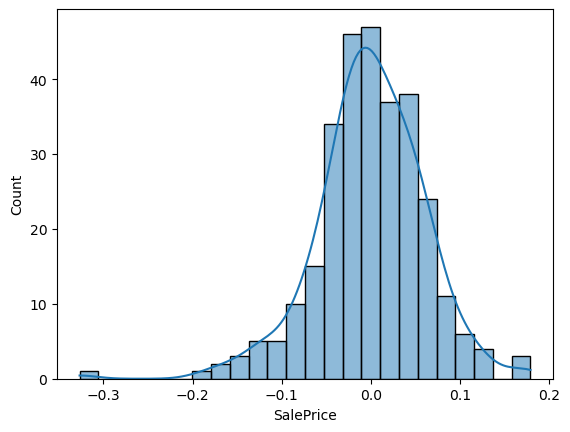

In [190]:
sb.histplot(ErrorDT,kde=True) # show error on graph

#### Conclusion:

* In Decision Tree R2_Score after Hyper-parameter tuning for testing data is **75.48%** and for training data is **84.50%**.
* RMSE after Hyper-parameter tuning for testing data is **0.06105**  and for training data is **0.05174** .
* Here we can see that model show **underfitting** model.
* Error also show skewed in left.

## K-Nearest Neighbors (KNN)

In [191]:
from sklearn.neighbors import KNeighborsRegressor # Import KNN call
KNN = KNeighborsRegressor() # call the KNN Algorithm
KNN.fit(x_train,y_train) # train the model

KNeighborsRegressor()

In [192]:
y_preKNN = KNN.predict(x_test) # predict the testing data

In [193]:
r2_score(y_test,y_preKNN) # check the model Performance for testing data

0.7794225546797123

In [194]:
root_mean_squared_error(y_test,y_preKNN) # check root mean squared  error for testing data

0.05791156296571494

In [195]:
y_trainKNN = KNN.predict(x_train) # predict the training data

In [196]:
r2_score(y_train,y_trainKNN)  # check model performance for training data

0.845512213621834

In [197]:
root_mean_squared_error(y_train,y_trainKNN) # check root mean squared  error for training data

0.05167183826770496

#### Now apply Hyper-parameter Tuning

In [198]:
# Define param grid
param_gridKNN = {
    'n_neighbors': [1,3, 5, 7],            # Number of neighbors to use for prediction
    'weights': ['uniform', 'distance'],          # Weight function used in prediction
    'algorithm': ['auto', 'ball_tree', 'kd_tree', 'brute'],  # Algorithm used to compute the nearest neighbors
    'leaf_size': [10, 20, 30],          # Leaf size passed to the underlying tree-based algorithms
    'p': [1, 2]                                  # Power parameter for the Minkowski distance (1 for Manhattan, 2 for Euclidean)
}


In [199]:
#  Random search on KNN with 5-fold cross-validation and 100 iterations, using R2 score

KNN_grid = RandomizedSearchCV(estimator=KNN,param_distributions=param_gridKNN,cv=5, scoring='r2', verbose=2, n_jobs=-1,n_iter=100,random_state=21)

In [200]:
KNN_grid.fit(x_train,y_train) #train the model

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=KNeighborsRegressor(), n_iter=100, n_jobs=-1,
                   param_distributions={'algorithm': ['auto', 'ball_tree',
                                                      'kd_tree', 'brute'],
                                        'leaf_size': [10, 20, 30],
                                        'n_neighbors': [1, 3, 5, 7],
                                        'p': [1, 2],
                                        'weights': ['uniform', 'distance']},
                   random_state=21, scoring='r2', verbose=2)

In [201]:
y_hypKNN = KNN_grid.predict(x_test) # predict the testing data

In [202]:
r4=r2_score(y_test,y_hypKNN) # check model performance for testing data
r4

0.8244217632219812

In [203]:
R4=root_mean_squared_error(y_test,y_hypKNN) # check root mean squared  error for testing data
R4

0.05166781270771961

In [204]:
y_trainhypKNN = KNN_grid.predict(x_train) # predict the training data

In [205]:
r2_score(y_train,y_trainhypKNN) # check model performance for training data

1.0

In [206]:
root_mean_squared_error(y_train,y_trainhypKNN) # check root mean squared  error for training data

0.0

In [207]:
ErrorKNN =   y_test - y_hypKNN # check the error 

In [208]:
ErrorKNN

335     0.033125
1074   -0.005481
933    -0.006635
982    -0.078003
921    -0.006465
573     0.001382
446    -0.008413
896    -0.031308
1429   -0.020739
1214   -0.012185
1122    0.040044
127    -0.036746
536    -0.020824
1240    0.027640
1387    0.039462
1174    0.097776
1183   -0.025366
280     0.011992
568     0.068813
609    -0.027069
912    -0.051752
283    -0.007934
556     0.002878
950    -0.026853
1274    0.027095
1200    0.004204
540    -0.012469
980     0.034430
1106   -0.079514
1434    0.007149
152     0.010351
25      0.004275
599     0.053083
911     0.031149
315    -0.001668
215     0.019914
655    -0.034929
425    -0.040684
284    -0.012964
482    -0.040211
1142    0.058966
1139    0.074151
242    -0.075317
1088    0.015850
1394    0.029236
721    -0.006781
591     0.064965
10      0.020551
187     0.008819
472     0.013096
789     0.010259
1352    0.079576
787     0.014311
483     0.003266
908    -0.021535
81     -0.047223
1426    0.073899
586     0.011091
370    -0.0228

<Axes: xlabel='SalePrice', ylabel='Count'>

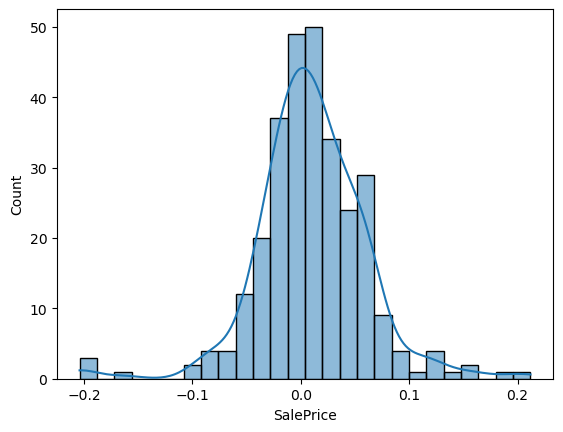

In [209]:
sb.histplot(ErrorKNN,kde=True) # show error on graph

#### Conclusion

* In KNN R2_Score after Hyper-parameter tuning for testing data is **82.44%** and for training data is **100%**.
* RMSE after Hyper-parameter tuning for testing data is **0.05166** and for training data is **0.0**.
* Here we can see that the  model show **Undetfitting** model.
* But Error show Nearly normal distribution.

## Bagging Algorithm

In [210]:
from sklearn.ensemble import BaggingRegressor # import Bagging Algorithm
BG = BaggingRegressor(random_state=20) # call the BG algorithm
BG.fit(x_train,y_train) # train the model

BaggingRegressor(random_state=20)

In [211]:
y_preBG = BG.predict(x_test) # predict the testing data

In [212]:
r2_score(y_test,y_preBG) # check the model performance

0.8757259000186248

In [213]:
root_mean_squared_error(y_test,y_preBG) # check root mean squared  error for testing data

0.0434685394654203

In [214]:
y_trainBG = BG.predict(x_train) # predict the training data

In [215]:
r2_score(y_train,y_trainBG) # check model performance for training data

0.9752237583983008

In [216]:
root_mean_squared_error(y_train,y_trainBG) # check root mean squared  error for training data

0.020693052076608813

#### Now apply Hyper-parameter Tuning

In [217]:
# Define the parameter grid for BaggingRegressor
param_gridBG = {
    'n_estimators': [100, 200],  # Number of base estimators in the ensemble
    'max_samples': [0.5, 0.75, 1.0],     # Proportion of the dataset to draw to train each base estimator
    'max_features': [0.5, 0.75, 1.0],    # Proportion of features to draw to train each base estimator
    'bootstrap': [True, False],          # Whether to use bootstrap samples when building trees                
}

In [218]:
#  Random search on Bagging with 5-fold cross-validation and 100 iterations, using R2 score

BG_grid = RandomizedSearchCV(estimator=BG,param_distributions=param_gridBG,cv=5,scoring='r2',verbose=2, n_jobs=-1,n_iter=100,random_state=42)

In [219]:
BG_grid.fit(x_train,y_train) #train model

Fitting 5 folds for each of 36 candidates, totalling 180 fits


RandomizedSearchCV(cv=5, estimator=BaggingRegressor(random_state=20),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'max_features': [0.5, 0.75, 1.0],
                                        'max_samples': [0.5, 0.75, 1.0],
                                        'n_estimators': [100, 200]},
                   random_state=42, scoring='r2', verbose=2)

In [220]:
y_hypBG= BG_grid.predict(x_test) # predict the testing data

In [221]:
r5=r2_score(y_test,y_hypBG) # check model performance for testing data
r5

0.8810487700400768

In [222]:
R5=root_mean_squared_error(y_test,y_hypBG) # check root mean squared  error for testing data
R5

0.042527436369294166

In [223]:
y_trainhypBG = BG_grid.predict(x_train) # predict the training data

In [224]:
r2_score(y_train,y_trainhypBG) # check model performance for training data

0.9999998116313549

In [225]:
root_mean_squared_error(y_train,y_trainhypBG) # check root mean squared  error for training data

5.705729047486155e-05

In [226]:
ErrorBG = y_test - y_hypBG # check the error 
ErrorBG

335     0.067195
1074   -0.010771
933    -0.032623
982    -0.027443
921    -0.063600
573    -0.005509
446    -0.035671
896     0.048373
1429   -0.007482
1214    0.007753
1122    0.052871
127    -0.027441
536    -0.015302
1240    0.015618
1387   -0.052345
1174    0.045542
1183   -0.042563
280     0.005108
568     0.054504
609    -0.012372
912    -0.049109
283    -0.000268
556     0.000016
950    -0.003944
1274    0.027818
1200    0.011979
540    -0.032329
980     0.007242
1106   -0.050058
1434    0.003302
152    -0.001835
25      0.019514
599     0.006513
911    -0.006880
315     0.011494
215    -0.026182
655    -0.014035
425    -0.021720
284    -0.022339
482    -0.068366
1142    0.052742
1139    0.028317
242    -0.089830
1088    0.018245
1394    0.036460
721    -0.002969
591     0.029689
10     -0.002474
187    -0.002237
472     0.018055
789    -0.028239
1352    0.031642
787     0.009018
483     0.000038
908    -0.012532
81     -0.045991
1426    0.037054
586     0.049565
370    -0.0131

<Axes: xlabel='SalePrice', ylabel='Count'>

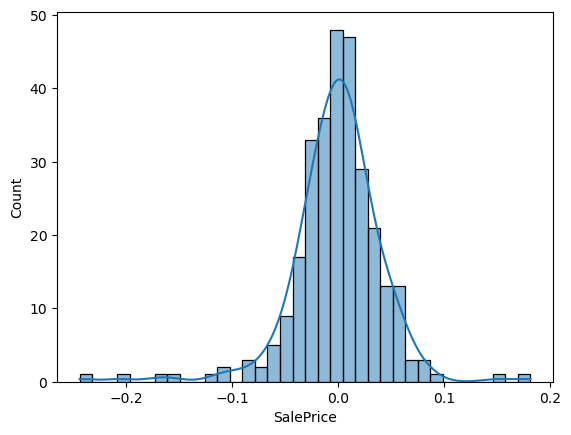

In [227]:
sb.histplot(ErrorBG,kde=True) # show error on graph

#### Conclusion

* In Bagging Algorithm R2_Score after Hyper-parameter tuning for testing data is **88.10%** and for training data is **99.99%**.
* RMSE after Hyper-parameter tuning for testing data is **0.04252** and for training data is **0.0005**.
* Here we can see that the  model show **Underfitting** model.
* Error also show Nearly skewed on left.

## RandomForest Algorithm

In [228]:
from sklearn.ensemble import RandomForestRegressor # import randomforest algorithm
RM = RandomForestRegressor() # store the RM algorithm
RM.fit(x_train,y_train) # train the model

RandomForestRegressor()

In [229]:
y_preRF = RM.predict(x_test) # predict the testning data

In [230]:
r2_score(y_test,y_preRF) # check the model performane

0.8818993177773774

In [231]:
root_mean_squared_error(y_test,y_preRF) # check root mean squared  error for testing data

0.042375119712741334

In [232]:
y_trainRF=RM.predict(x_train) # predict the training data

In [233]:
r2_score(y_train,y_trainRF) # check model performance for training data

0.9824043974970593

In [234]:
root_mean_squared_error(y_train,y_trainRF) # check root mean squared  error for training data

0.017438491269148936

#### Now apply Hyper-parameter Tuning

In [235]:
# define Param grid
param_gridRM={
    'n_estimators': [100, 200, 500],         # Number of trees
    'max_features':  ['sqrt', 'log2'],      # Number of features to consider at each split
    'max_depth': [ 10, 20, 30],       # Maximum depth of the tree
    'min_samples_split': [1,2, 5, 10],               # Minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4],                 # Minimum number of samples required at each leaf node
    'bootstrap': [True, False],                    # Whether bootstrap samples are used when building trees
    'criterion': ['squared_error', 'absolute_error'],  # Function to measure the quality of the split
}

In [236]:
#  Random search on Random Forest with 5-fold cross-validation and 100 iterations, using R2 score

RM_grid = RandomizedSearchCV(estimator=RM,param_distributions=param_gridRM,cv=5,scoring= 'r2',verbose=2, n_jobs=-1,n_iter=100,random_state=42)

In [237]:
RM_grid.fit(x_train,y_train) #train model

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=RandomForestRegressor(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'bootstrap': [True, False],
                                        'criterion': ['squared_error',
                                                      'absolute_error'],
                                        'max_depth': [10, 20, 30],
                                        'max_features': ['sqrt', 'log2'],
                                        'min_samples_leaf': [1, 2, 4],
                                        'min_samples_split': [1, 2, 5, 10],
                                        'n_estimators': [100, 200, 500]},
                   random_state=42, scoring='r2', verbose=2)

In [238]:
y_hypRF = RM_grid.predict(x_test) # predict the testing data

In [239]:
r6=r2_score(y_test,y_hypRF) #check model performance for testing data
r6

0.8861908059158539

In [240]:
R6=root_mean_squared_error(y_test,y_hypRF) # check root mean squared  error for testing data
R6

0.04159809179369755

In [241]:
y_trainhypRF = RM_grid.predict(x_train)  # predict the training  data

In [242]:
r2_score(y_train,y_trainhypRF) #check model performance for training data

0.9999999992888812

In [243]:
root_mean_squared_error(y_train,y_trainhypRF) # check root mean squared  error for training data

3.5057257746358603e-06

In [244]:
ErrorRF = y_test - y_hypRF #check error
ErrorRF

335     0.073916
1074   -0.013069
933    -0.027793
982    -0.030525
921    -0.031194
573    -0.006965
446    -0.042577
896     0.031970
1429   -0.020269
1214    0.007358
1122    0.057875
127    -0.039417
536    -0.012487
1240    0.017645
1387   -0.043632
1174    0.062145
1183   -0.038767
280     0.013545
568     0.051305
609    -0.008823
912    -0.062695
283     0.003627
556    -0.003317
950    -0.005690
1274    0.024430
1200    0.020502
540    -0.028659
980     0.011577
1106   -0.053377
1434    0.002076
152     0.008278
25      0.009743
599     0.003812
911    -0.007255
315     0.012376
215    -0.022984
655    -0.021115
425    -0.011984
284    -0.019631
482    -0.044561
1142    0.056913
1139    0.032336
242    -0.089490
1088    0.018245
1394    0.029912
721    -0.002709
591     0.029965
10     -0.004026
187    -0.000654
472     0.016878
789    -0.017966
1352    0.047653
787     0.006515
483     0.000972
908    -0.015059
81     -0.045683
1426    0.036586
586     0.045707
370    -0.0139

<Axes: xlabel='SalePrice', ylabel='Count'>

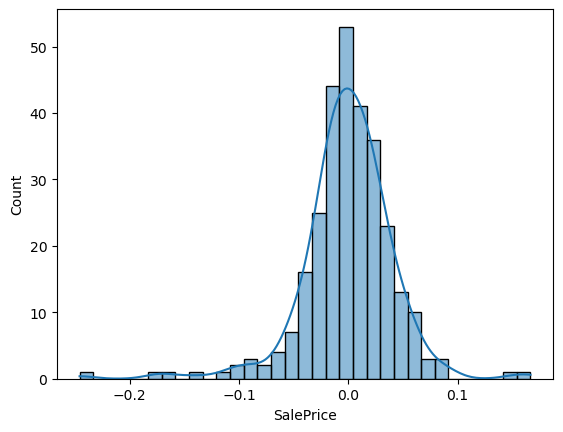

In [245]:
sb.histplot(ErrorRF,kde=True) # show error on graph

### Colclusion

* In Random Forest R2_Score after Hyper-parameter tuning for testing data is **88.53%** and for training data is **99.67%**.
* RMSE after Hyper-parameter tuning for testing data is **0.04176** and for training data is **0.00745**.
* Here we can see that the  model show **UnderFitting** model.
* Error a show Nearly Normal Distribution.

## Gradiant Boosting Algorithm

In [246]:
from sklearn.ensemble import GradientBoostingRegressor # import the Gradinat boosting Algorithm
GB = GradientBoostingRegressor() # call the Gradinat boosting algorithm
GB.fit(x_train,y_train) # train the data

GradientBoostingRegressor()

In [247]:
y_preGB = GB.predict(x_test) # predict the testing data

In [248]:
r2_score(y_test,y_preGB) # check the model performance for testing data

0.8841752745037456

In [249]:
root_mean_squared_error(y_test,y_preGB)# check root mean squared  error for testing data

0.04196482097678182

In [250]:
y_trainGB = GB.predict(x_train) # predict the training data

In [251]:
r2_score(y_train,y_trainGB)  # check the model performance for training data

0.9637304757440751

In [252]:
root_mean_squared_error(y_train,y_trainGB) # check root mean squared  error for training data

0.025036739263826532

#### Now apply Hyper-parameter tuning

In [253]:
#Define param grid
param_gridGB = {
    'n_estimators': [100, 200, 300],     # Number of boosting stages to be run
    'learning_rate': [0.001, 0.01, 0.1],  # Step size shrinkage used in the update to prevent overfitting
    'max_depth': [1,3, 5],                      # Maximum depth of the individual regression estimators
    'min_samples_split': [1,2, 5],                 # Minimum number of samples required to split an internal node
    'min_samples_leaf': [1, 2, 5],                   # Minimum number of samples required to be at a leaf node
    'subsample': [0.6, 0.7, 0.8],               # Fraction of samples to be used for fitting the individual base learners
    'max_features': ['sqrt', 'log2'],                 # Number of features to consider when looking for the best split
}


In [254]:
#  Random search on Gradiant Boosting with 5-fold cross-validation and 100 iterations, using R2 score

GB_grid = RandomizedSearchCV(estimator=GB,param_distributions=param_gridGB,cv=5,scoring= 'r2',verbose=2, n_jobs=-1,n_iter=100,random_state=1)

In [255]:
GB_grid.fit(x_train,y_train) #train model

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=GradientBoostingRegressor(), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'learning_rate': [0.001, 0.01, 0.1],
                                        'max_depth': [1, 3, 5],
                                        'max_features': ['sqrt', 'log2'],
                                        'min_samples_leaf': [1, 2, 5],
                                        'min_samples_split': [1, 2, 5],
                                        'n_estimators': [100, 200, 300],
                                        'subsample': [0.6, 0.7, 0.8]},
                   random_state=1, scoring='r2', verbose=2)

In [256]:
y_hypGB = GB_grid.predict(x_test) # predict the testing data

In [257]:
r7=r2_score(y_test,y_hypGB) # check root mean squared  error for testing data
r7

0.8895358211363313

In [258]:
R7=root_mean_squared_error(y_test,y_hypGB) # check root mean squared  error for testing data
R7

0.04098221894911017

In [259]:
y_trainhypGB = GB_grid.predict(x_train) # predict the training data

In [260]:
r2_score(y_train,y_trainhypGB) # check root mean squared  error for training data

0.9756526116029306

In [261]:
root_mean_squared_error(y_train,y_trainhypGB) # check root mean squared  error for training data

0.020513181796620074

In [262]:
ErrorGB = y_test - y_hypGB #check error value
ErrorGB

335     0.065032
1074    0.001505
933    -0.025037
982    -0.017588
921    -0.032957
573    -0.001821
446    -0.056371
896     0.018589
1429   -0.026644
1214    0.024027
1122    0.093322
127    -0.023286
536    -0.009139
1240    0.029502
1387   -0.055394
1174    0.014165
1183   -0.037316
280    -0.016172
568     0.012695
609    -0.005324
912    -0.031911
283     0.020872
556    -0.013556
950    -0.006906
1274    0.009810
1200    0.061434
540    -0.058672
980    -0.037105
1106   -0.050349
1434   -0.008823
152     0.004106
25      0.022542
599    -0.013061
911    -0.021859
315     0.003262
215    -0.028090
655    -0.027896
425    -0.006732
284    -0.018729
482    -0.060090
1142   -0.003055
1139    0.057153
242    -0.079091
1088    0.005573
1394    0.013518
721    -0.003042
591     0.044062
10      0.004336
187    -0.000480
472     0.027591
789    -0.023228
1352   -0.001095
787     0.020836
483    -0.000086
908    -0.027902
81     -0.053742
1426    0.025154
586     0.015134
370    -0.0123

<Axes: xlabel='SalePrice', ylabel='Count'>

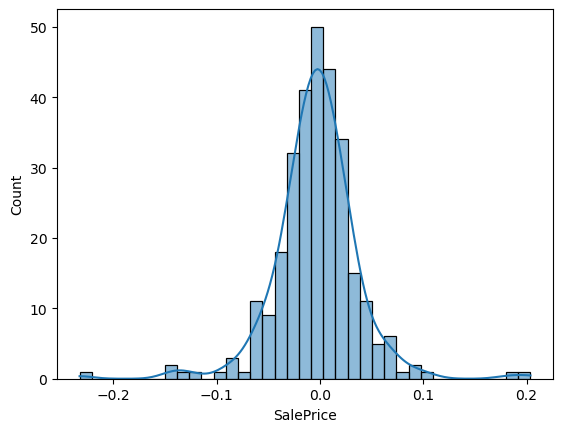

In [263]:
sb.histplot(ErrorGB,kde=True) # show error on graph

### Conclusion:

* In Gradiant Boosting R2_Score after Hyper-parameter tuning for testing data is **88.95%** and for training data is **97.56%**.
* RMSE after Hyper-parameter tuning for testing data is **0.04223** and for training data is **0.01731**.
* Here we can see that the  model show **Underfitting** model.
* Error show Nearly normal distribution.

# Extrem Gradiant Boosting

In [264]:
from xgboost import XGBRegressor #import model
xgb=XGBRegressor() # call the model
xgb.fit(x_train,y_train) #train model

XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, device=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=None, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=None, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             multi_strategy=None, n_estimators=None, n_jobs=None,
             num_parallel_tree=None, random_state=None, ...)

In [265]:
y_preXGB = xgb.predict(x_test) # predict the testing data

In [266]:
r2_score(y_test,y_preXGB) # check the model performance for testing data

0.8646029396783849

In [267]:
root_mean_squared_error(y_test,y_preXGB) # check root mean squared  error for testing data

0.0453721493080606

In [268]:
y_trainXGB = xgb.predict(x_train) # predict the training data

In [269]:
r2_score(y_train,y_trainXGB) # check the model performance for training data

0.9997974187869284

In [270]:
root_mean_squared_error(y_train,y_trainXGB)  # check root mean squared  error for training data

0.0018711405937500256

#### Now apply hyper-parameter tuning

In [271]:
# Define the hyperparameter grid
param_gridXGB = {
    'n_estimators': [100, 200, 300],       # Number of boosting rounds (trees) to be built
    'learning_rate': [0.01, 0.001, 0.1],           # Step size shrinkage used in update to prevent overfitting*/
    'max_depth': [1,3, 5],                     # Maximum depth of a tree, increasing this value will make the model more complex
    'min_child_weight': [1, 3, 5, 7],                  # Minimum sum of instance weight (hessian) needed in a child
    'subsample': [0.6, 0.7, 0.8],                # Fraction of samples used for each boosting round; controls overfitting
    'colsample_bytree': [0.6, 0.7, 0.8],         # Fraction of features used for each tree; helps prevent overfitting
    'gamma': [0.1, 0.2, 0.5, 1],                    # Minimum loss reduction required to make a further partition on a leaf node
    'reg_alpha': [0.1, 1, 10],                      # L1 regularization term on weights; can help with feature selection
    'reg_lambda': [0.1, 1, 10] ,                     # L2 regularization term on weights; helps to reduce model complexity
}


In [272]:
#  Random search on Extrem Gradiant Boosting with 5-fold cross-validation and 100 iterations, using R2 score

XGB_grid = RandomizedSearchCV(estimator=xgb,param_distributions=param_gridXGB,cv=5,scoring= 'r2',verbose=2, n_jobs=-1,n_iter=100)

In [273]:
XGB_grid.fit(x_train,y_train) #train model

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5,
                   estimator=XGBRegressor(base_score=None, booster=None,
                                          callbacks=None,
                                          colsample_bylevel=None,
                                          colsample_bynode=None,
                                          colsample_bytree=None, device=None,
                                          early_stopping_rounds=None,
                                          enable_categorical=False,
                                          eval_metric=None, feature_types=None,
                                          gamma=None, grow_policy=None,
                                          importance_type=None,
                                          interaction_constraints=None,
                                          learning_rate=...
                                          num_parallel_tree=None,
                                          random_state=None, ...),
                   n_iter=100, n_jobs=-1,
                   param_distributions={'colsample_bytree': [0.6, 0.7, 0.8],
                                        'gamma': [0.1, 0.2, 0.5, 1],
                                        'learning_rate': [0.01, 0.001, 0.1],
                                        'max_depth': [1, 3, 5],
                                        'min_child_weight': [1, 3, 5, 7],
                                        'n_estimators': [100, 200, 300],
                                        'reg_alpha': [0.1, 1, 10],
                                        'reg_lambda': [0.1, 1, 10],
                                        'subsample': [0.6, 0.7, 0.8]},
                   scoring='r2', verbose=2)

In [274]:
y_hypXGB = XGB_grid.predict(x_test) # predict the testing data

In [275]:
r8=r2_score(y_test,y_hypXGB) # check the model performance for testing data
r8

0.8521230512190712

In [276]:
R8=root_mean_squared_error(y_test,y_hypXGB) # check root mean squared  error for testing data
R8

0.04741709848789253

In [277]:
y_trainhypXGB = XGB_grid.predict(x_train) # predict the training data

In [278]:
r2_score(y_train,y_trainhypXGB) # check the model performance for training data

0.8885461872264764

In [279]:
root_mean_squared_error(y_train,y_trainhypXGB)  # check root mean squared  error for training data

0.04388886017642546

In [280]:
ErrorXGB = y_test - y_hypXGB #check error value
ErrorXGB

335     0.070382
1074   -0.007614
933    -0.029692
982    -0.040059
921    -0.032943
573     0.016071
446    -0.060970
896     0.036985
1429   -0.021863
1214    0.023874
1122    0.064203
127    -0.056546
536    -0.004203
1240    0.041049
1387   -0.034192
1174    0.112109
1183   -0.039626
280    -0.002147
568     0.022209
609    -0.008229
912    -0.044152
283     0.009426
556     0.001306
950    -0.012293
1274    0.045895
1200    0.020361
540    -0.034834
980     0.012601
1106   -0.031816
1434    0.004681
152     0.016414
25     -0.003851
599    -0.027117
911    -0.004228
315     0.014293
215    -0.034091
655    -0.063096
425    -0.004444
284    -0.032621
482    -0.075553
1142    0.068235
1139    0.024644
242    -0.061982
1088   -0.083612
1394    0.027028
721    -0.012753
591     0.058925
10     -0.009382
187     0.013093
472     0.027777
789    -0.009894
1352    0.014483
787     0.010876
483     0.015091
908    -0.011581
81     -0.021134
1426    0.035500
586     0.016385
370     0.0023

<Axes: xlabel='SalePrice', ylabel='Count'>

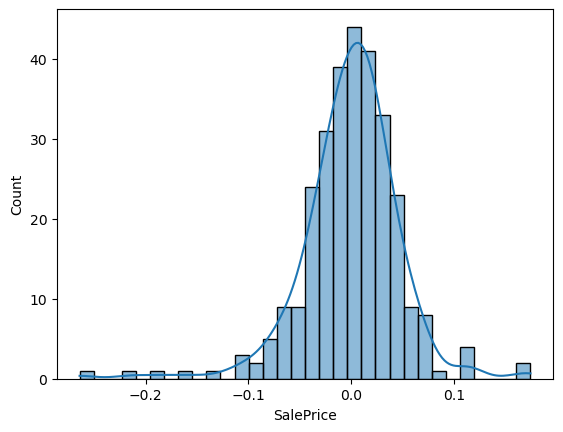

In [281]:
sb.histplot(ErrorXGB,kde=True) # show error on graph

## Conclusion:

* In Extrem Gradiant Boosting R2_Score after Hyper-parameter tuning for testing data is **85.21%** and for training data is **88.85%**.
* RMSE after Hyper-parameter tuning for testing data is **0.04741** and for training data is **0.04388**.
* Here we can see that the  model show **Generalized** model.
* Error also show Nearly normal distribution.

# Addaboosting

In [282]:
from sklearn.ensemble import AdaBoostRegressor  # Import Model
AD = AdaBoostRegressor() #call the model
AD.fit(x_train,y_train) # train the model

AdaBoostRegressor()

In [283]:
y_preAD = AD.predict(x_test)  # predict the testing data

In [284]:
r2_score(y_test,y_preAD)# check the model performance for testing data

0.8110504359233288

In [285]:
root_mean_squared_error(y_test,y_preAD) # check root mean squared  error for testing data

0.05359912279680508

In [286]:
y_trainAD = AD.predict(x_train) # predict the training data

In [287]:
r2_score(y_train,y_trainAD) # check the model performance for training data

0.872522970387995

In [288]:
root_mean_squared_error(y_train,y_trainAD) # check root mean squared  error for training data

0.04693780805793645

#### Now apply Hyper parameter tuning

In [289]:
# Define the hyperparameter grid
param_gridAD = {
    'n_estimators': [100, 200, 500],                # Number of boosting rounds or weak learners
    'learning_rate': [0.01, 0.001, 0.1, 0.2],       # Shrinks the contribution of each weak learner to prevent overfitting
    'loss': ['linear', 'square', 'exponential']    # Loss function to use for the regressor's update step
}


In [290]:
#  Random search on Adda Boosting with 5-fold cross-validation and 100 iterations, using R2 score

AD_grid = RandomizedSearchCV(estimator=AD,param_distributions=param_gridAD,cv=5,scoring= 'r2',verbose=2, n_jobs=-1,n_iter=100,random_state=42)

In [291]:
AD_grid.fit(x_train,y_train) # train model

Fitting 5 folds for each of 36 candidates, totalling 180 fits


RandomizedSearchCV(cv=5, estimator=AdaBoostRegressor(), n_iter=100, n_jobs=-1,
                   param_distributions={'learning_rate': [0.01, 0.001, 0.1,
                                                          0.2],
                                        'loss': ['linear', 'square',
                                                 'exponential'],
                                        'n_estimators': [100, 200, 500]},
                   random_state=42, scoring='r2', verbose=2)

In [292]:
y_hypAD  = AD_grid.predict(x_test) # predict the testing data

In [293]:
r9=r2_score(y_test,y_hypAD)# check the model performance for testing data
r9

0.8181458742415412

In [294]:
R9=root_mean_squared_error(y_test,y_hypAD) # check root mean squared  error for testing data
R9

0.052583115509526886

In [295]:
y_trainhypAD = AD_grid.predict(x_train) # predict the training data

In [296]:
r2_score(y_train,y_trainhypAD) # check the model performance for training data

0.8710437664635098

In [297]:
root_mean_squared_error(y_train,y_trainhypAD) # check root mean squared  error for training data

0.04720934849740489

In [298]:
ErrorAD = y_test - y_hypAD #check error values
ErrorAD

335     0.108134
1074    0.000707
933    -0.033247
982    -0.057737
921     0.000642
573    -0.027769
446    -0.005417
896     0.087859
1429   -0.006864
1214    0.034771
1122    0.070266
127    -0.017167
536    -0.004078
1240    0.041243
1387   -0.066839
1174    0.109646
1183   -0.026960
280     0.019234
568     0.042958
609     0.066513
912    -0.022077
283     0.005361
556     0.046444
950     0.017586
1274    0.086744
1200    0.068953
540    -0.014668
980    -0.011004
1106   -0.057775
1434    0.037672
152     0.042970
25      0.013719
599    -0.011088
911     0.031033
315    -0.021966
215     0.008078
655    -0.044025
425    -0.026435
284     0.006278
482    -0.069469
1142    0.115538
1139    0.045462
242    -0.124534
1088   -0.082333
1394   -0.018013
721    -0.001612
591     0.071859
10      0.026694
187     0.017785
472     0.013026
789     0.017457
1352    0.026008
787     0.040326
483     0.029565
908     0.020243
81     -0.006856
1426    0.019597
586     0.057453
370     0.0181

<Axes: xlabel='SalePrice', ylabel='Count'>

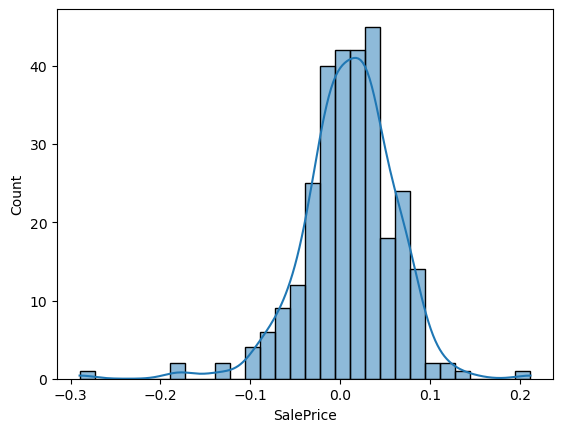

In [299]:
sb.histplot(ErrorAD,kde=True) # show error on graph

### Conclusion

* In Adda Boosting  R2_Score after Hyper-parameter tuning for testing data is **81.81%** and for training data is **87.10%**.
* RMSE after Hyper-parameter tuning for testing data is **0.05258** and for training data is **0.04720**.
* Here we can see that the  model show **nearly Underfitting** model.
* Error show nearly Normal Distribution.

# Artificial Neural Network (ANN)

In [300]:
from sklearn.neural_network import MLPRegressor #import model
ANN = MLPRegressor(random_state=20) #call the model
ANN.fit(x_train,y_train) # train model

MLPRegressor(random_state=20)

In [301]:
y_preANN = ANN.predict(x_test) # predict the testing data

In [302]:
r2_score(y_test,y_preANN)# check the model performance for testing data

0.784043513146045

In [303]:
root_mean_squared_error(y_test,y_preANN) # check root mean squared  error for testing data

0.05730174687191077

In [304]:
y_trainANN = ANN.predict(x_train) # predict the training data

In [305]:
r2_score(y_train,y_trainANN) # check the model performance for training data

0.8555865694213781

In [306]:
root_mean_squared_error(y_train,y_trainANN) # check root mean squared  error for training data

0.049958642555616

#### Now apply hyper-parameter tuning

In [307]:
# Define the hyperparameter grid
param_gridANN = {
    'hidden_layer_sizes': [(50,), (100,), (100, 50), (150, 100, 50)],  # Varying number of neurons and layers
    'activation': ['tanh', 'relu'],  # Activation functions
    'solver': ['lbfgs', 'sgd', 'adam'],  # Solvers
    'alpha': [0.0001, 0.001, 0.01, 0.1],  # Regularization term (L2 penalty)
    'learning_rate': ['constant', 'invscaling', 'adaptive'],  # Learning rate schedule
    'learning_rate_init': [0.1,0.2,0.3],  # Initial learning rate
    'max_iter': [100, 200, 500, 1000],  # Maximum number of iterations
}

In [308]:
#  Random search on ANN with 5-fold cross-validation and 100 iterations, using R2 score

ANN_grid = RandomizedSearchCV(estimator=ANN,param_distributions=param_gridANN,cv=5,scoring= 'r2',verbose=2, n_jobs=-1,n_iter=100,random_state=42)

In [309]:
ANN_grid.fit(x_train,y_train) #predict testing data

Fitting 5 folds for each of 100 candidates, totalling 500 fits


RandomizedSearchCV(cv=5, estimator=MLPRegressor(random_state=20), n_iter=100,
                   n_jobs=-1,
                   param_distributions={'activation': ['tanh', 'relu'],
                                        'alpha': [0.0001, 0.001, 0.01, 0.1],
                                        'hidden_layer_sizes': [(50,), (100,),
                                                               (100, 50),
                                                               (150, 100, 50)],
                                        'learning_rate': ['constant',
                                                          'invscaling',
                                                          'adaptive'],
                                        'learning_rate_init': [0.1, 0.2, 0.3],
                                        'max_iter': [100, 200, 500, 1000],
                                        'solver': ['lbfgs', 'sgd', 'adam']},
                   random_state=42, scoring='r2', verbose=2)

In [310]:
y_hypANN = ANN_grid.predict(x_test) # predict the testing data

In [311]:
r10=r2_score(y_test,y_hypANN)# check the model performance for testing data
r10

0.8826011167586145

In [312]:
R10=root_mean_squared_error(y_test,y_hypANN) # check root mean squared  error for testing data
R10

0.0422490276069782

In [313]:
y_trainhypANN = ANN_grid.predict(x_train) # predict the training data

In [314]:
r2_score(y_train,y_trainhypANN) # check the model performance for training data

0.9020345750504593

In [315]:
root_mean_squared_error(y_train,y_trainhypANN) # check root mean squared  error for training data

0.04114748071741054

In [316]:
ErrorANN = y_test- y_hypANN #check error value
ErrorANN

335    -0.031816
1074   -0.003497
933    -0.025090
982    -0.050871
921    -0.050917
573     0.016265
446    -0.060303
896     0.051474
1429   -0.057281
1214    0.032440
1122    0.064603
127    -0.039495
536    -0.018006
1240    0.033721
1387   -0.084302
1174    0.059003
1183   -0.046364
280     0.005634
568     0.016637
609     0.020745
912    -0.010477
283     0.014561
556     0.019781
950    -0.041320
1274    0.000843
1200    0.097656
540    -0.027897
980    -0.053682
1106   -0.078678
1434    0.021823
152     0.027636
25      0.026795
599    -0.021893
911    -0.055315
315    -0.008955
215    -0.006246
655    -0.029590
425    -0.020454
284    -0.008523
482    -0.053580
1142    0.035094
1139    0.061192
242    -0.052668
1088   -0.034898
1394    0.001682
721     0.000358
591     0.022747
10      0.012673
187     0.042908
472     0.029400
789    -0.049721
1352    0.010274
787     0.008478
483    -0.018306
908    -0.023178
81     -0.061416
1426    0.028407
586     0.043872
370    -0.0055

<Axes: xlabel='SalePrice', ylabel='Count'>

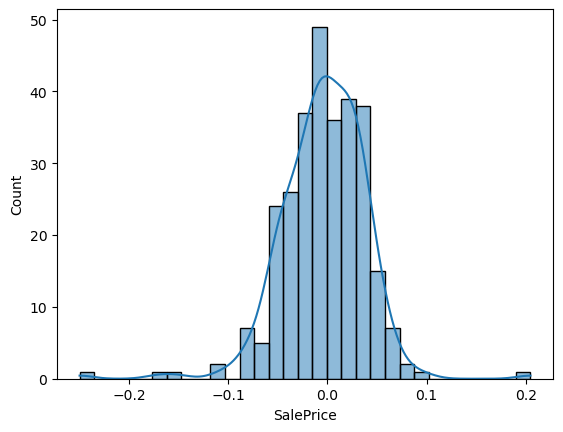

In [317]:
sb.histplot(ErrorANN,kde=True)# show error on graph

### Conclusion:

* In ANN R2_Score after Hyper-parameter tuning for testing data is **88.26%** and for training data is **90.20%**.
* RMSE after Hyper-parameter tuning for testing data is **0.04224** and for training data is **0.04114**.
* Here we can see that the  model show **Generalized** model.
* Error also show Nearly normal distribution.

# Model Comparison Report

In [318]:
# check the all algorithm model perforamnce in table form
# check the Model name, r2_score, root_mean_squer_error
score = pd.DataFrame({"Model":["Linear Regression",'SVM','Decision Tree','KNN','Bagging','Random Forest','Gradiant Boosting',
                              'Extrem Gradiant Boosting','Ada Boosting','ANN'],
                     "r2_score":[r1*100,r2*100,r3*100,r4*100,r5*100,r6*100,r7*100,r8*100,r9*100,r10*100],
                     "RMSE":[R1,R2,R3,R4,R5,R6,R7,R8,R9,R10]})
score

,Model,r2_score,RMSE
0,Linear Regression,89.623586,0.039720
1,SVM,90.230559,0.038541
2,Decision Tree,75.480203,0.061058
3,KNN,82.442176,0.051668
4,Bagging,88.104877,0.042527
5,Random Forest,88.619081,0.041598
6,Gradiant Boosting,88.953582,0.040982
7,Extrem Gradiant Boosting,85.212305,0.047417
8,Ada Boosting,81.814587,0.052583
9,ANN,88.260112,0.042249


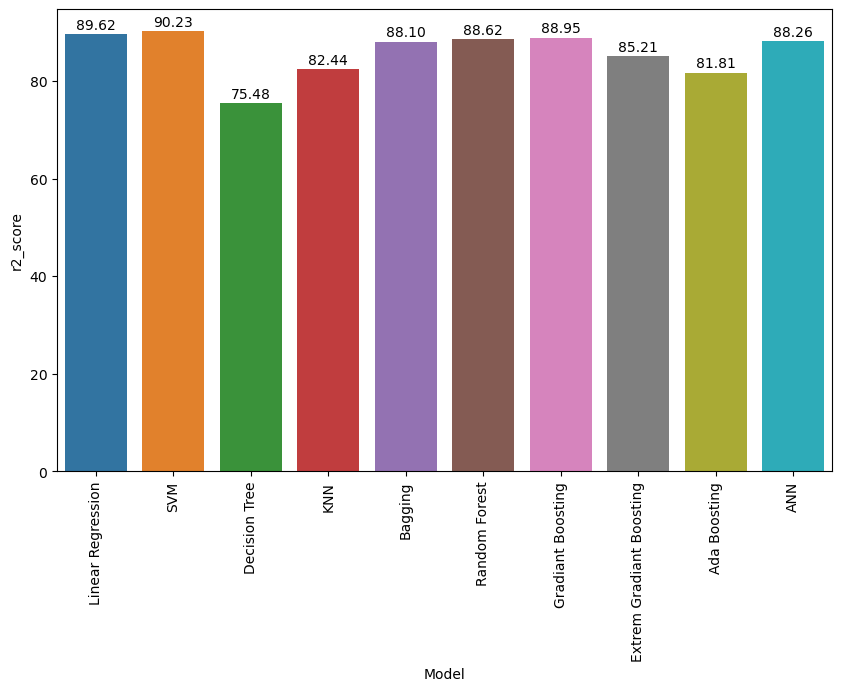

In [319]:
# make bar graph for all model's performance
plt.figure(figsize=(10, 6)) # define the plot size
plt.xticks(rotation = 90) # show the x axis value rotation
a = sb.barplot(x=score.Model, y=score.r2_score, data=score) # create the barplot

for index, value in enumerate(score['r2_score']): # show indivisual bar values show
    a.text(index, value + 1, f'{value:.2f}', ha='center')

# Final Colclusion

* During the analysis, 10 different models were applied to predict house prices. The performance of each model was evaluated using two main metrics: R2 Score and RMSE (Root Mean Squared Error).
* Support Vector Machine (SVM) performed the best, achieving the highest R² score (90.23%) and the lowest RMSE (0.0385). It is the most accurate model in predicting house prices.

* Linear Regression performed admirably with an R² score of 89.62% and RMSE of 0.0397, showing that simpler models can still provide highly accurate predictions.

* Gradient Boosting and Random Forest demonstrated strong performance with R² scores of 88.95% and 88.62% respectively, and relatively low RMSE values. They are reliable models for generalization.

* Bagging Regressor and ANN also performed well, with R² scores of 88.10% and 88.26% respectively, showing that ensemble methods and neural networks can generalize effectively.

* K-Nearest Neighbors (KNN) delivered moderate performance, with an R² score of 82.44% and an RMSE of 0.0517, making it less accurate than other models.

* Extreme Gradient Boosting (XGBoost) and Ada Boosting had lower R² scores (85.21% and 81.81% respectively), with higher RMSE values, indicating moderate performance in this context.

* Decision Tree had the lowest R² score of 75.48% and the highest RMSE of 0.0611, indicating that it struggled the most with generalization.\

***SVM and Linear Regression are the top-performing model and are recommended for deployment due to its accuracy and generalization capabilities.***
***Gradient Boosting, and Random Forest also showed strong performance and are viable alternatives.***
  ***Most of the models demonstrate good generalization, capturing the patterns in the data effectively.***

# Here are some challenges which i faced during create this model:

**Handling Missing Data:-** Many features had missing values, which made it difficult to get accurate insights and required careful imputation or removal of data.

**Dealing with Outliers:-** Some features had extreme values that could affect the model's performance, so deciding whether to remove or keep outliers was challenging.

**Encoding Categorical Variables:-** There were many categorical variables (like neighborhoods or exterior materials) that needed proper encoding to be understood by machine learning models.

**Model Tuning:-** Finding the best hyperparameters for different models was time-consuming, and sometimes even after tuning, model performance didn’t improve as expected.

**Evaluation Metrics:-** Deciding which evaluation metric (e.g., R2 score, RMSE) was the best for assessing the model's performance was challenging, especially when different models gave varying results.

**Computational Time:-** With a large number of features and different algorithms, training models took a significant amount of time, especially during hyperparameter tuning.

# Model Save

In [320]:
import pickle # use for save the model
with open("House.pkl","wb") as f:  # define the file save
    pickle.dump(svr,f) # call the rm model

In [321]:
with open("House.pkl","rb") as f: # load the model file
    file = pickle.load(f) # call the file

                                                    ! Thank You !